<div style="text-align: center; background-color: #d8b26e; color: #black; padding: 20px; border-radius: 5px;">
    <h2 style="margin: 0; font-size: 20px;">Store Sales - Time Series Forecasting</h2>
</div>


![](https://i.makeagif.com/media/10-02-2018/774tEI.gif)


This competition is about time series forcasting for store sales. The data comes from an Ecuador company as known as Corporación Favorita and it is a large grocery retailer. Also, the company operates in other countries in South America.

If you wonder the company, you can click [**here**](https://www.corporacionfavorita.com/en/) to learn something about it.

<br>

<center><img src="https://github.com/EkremBayar/Kaggle/blob/main/Images/CF.png?raw=true" style="width:30%;height:10%;"></center>

<center><img src="https://github.com/EkremBayar/Kaggle/blob/main/Images/CF1.jpg?raw=true" style="width:30%;height:10%;"></center>

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="center"><font color=#006600>Goal of the Competition:</font></h2>

In this “getting started” competition, you’ll use time-series forecasting to forecast store sales on data from Corporación Favorita, a large Ecuadorian-based grocery retailer.

Specifically, you'll build a model that more accurately predicts the unit sales for thousands of items sold at different Favorita stores. You'll practice your machine learning skills with an approachable training dataset of dates, store, and item information, promotions, and unit sales.

![](https://player.slideplayer.com/97/16820156/slides/slide_1.jpg)

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="center"><font color=#006600>Context:</font></h2>

Forecasts aren’t just for meteorologists. Governments forecast economic growth. Scientists attempt to predict the future population. And businesses forecast product demand—a common task of professional data scientists. Forecasts are especially relevant to brick-and-mortar grocery stores, which must dance delicately with how much inventory to buy. Predict a little over, and grocers are stuck with overstocked, perishable goods. Guess a little under, and popular items quickly sell out, leading to lost revenue and upset customers. More accurate forecasting, thanks to machine learning, could help ensure retailers please customers by having just enough of the right products at the right time.

Current subjective forecasting methods for retail have little data to back them up and are unlikely to be automated. The problem becomes even more complex as retailers add new locations with unique needs, new products, ever-transitioning seasonal tastes, and unpredictable product marketing.

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="center"><font color=#006600>Potential Impact:</font></h2>

If successful, you'll have flexed some new skills in a real world example. For grocery stores, more accurate forecasting can decrease food waste related to overstocking and improve customer satisfaction. The results of this ongoing competition, over time, might even ensure your local store has exactly what you need the next time you shop.

<a id="libraries"></a>
# <b><span style='color:#c78a44'> Importing Necessary Libraries</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">
    
First of all, I will import all the necessary libraries that we will use throughout the project. This generally includes libraries for data manipulation, data visualization, and others based on the specific needs of the project:

In [1]:
!pip install darts

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.0/51.0 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.5/160.5 kB 10.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.7/154.7 kB 12.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 846.9/846.9 kB 37.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.7/120.7 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 279.8/279.8 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.5/53.5 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.0/40.0 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.2/169.2 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip install prophet

In [3]:
!pip install bar_chart_race

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.8/156.8 kB 5.6 MB/s eta 0:00:00


In [4]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from math import floor,ceil
import time
import itertools 

import warnings
import missingno as msno
from collections import Counter
from scipy.stats import spearmanr # for spearman
import scipy.stats as stats
import gc
import joblib
import bar_chart_race as bcr
import holidays as holi

# ANOVA
from statsmodels.formula.api import ols
import statsmodels.api as sm

# Preprocessing 
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder

from sklearn.metrics import mean_absolute_error

# prophet library
from prophet import Prophet
from prophet.diagnostics import performance_metrics
from prophet.plot import plot_cross_validation_metric
from prophet.diagnostics import cross_validation

# darts library
from darts import TimeSeries
from darts.models import RegressionModel

# H2O
import h2o # for Random Forest without having to encode the labels
from h2o.estimators import H2ORandomForestEstimator # for Random Forest without having to encode the labels
from h2o.estimators import xgboost,H2OXGBoostEstimator

h2o.init() # to be connected to all modules

from lightgbm import LGBMRegressor

# CONFIGURATIONS
# ------------------------------------------------------
pd.set_option("display.max_columns", None)
# pd.set_option("display.max_rows",None)
pd.set_option("display.float_format",lambda x:'%.2f'%x)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')
%matplotlib inline

def mape(actual,pred):
    """
    mean absolute percentage error(MAPE) fuction
    """
    actual,pred=np.array(actual),np.array(pred)
    return np.mean(np.abs((actual,pred)/actual))
    
def apply_styling_to_dataframe(df):
    return df.style.set_properties(**{"background-color": "#A2DBFA",
                                      "color": "black",
                                      "border": "1.5px solid black"
                                     }).bar(color="#F3F1F5", vmin=100_000)
def missing_data(input_data):
    '''
    This function returns dataframe with information about the percentage of nulls in each column and the column data type.
    
    input: pandas df
    output: pandas df
    
    '''
    
    total = input_data.isnull().sum()
    percent = (input_data.isnull().sum()/input_data.isnull().count()*100)
    table = pd.concat([total, percent], axis = 1, keys = ['Total', 'Percent'])
    types = []
    for col in input_data.columns: 
        dtype = str(input_data[col].dtype)
        types.append(dtype)
    table["Types"] = types
    return(pd.DataFrame(table))


/opt/conda/lib/python3.10/site-packages/dask/dataframe/_pyarrow_compat.py:23: UserWarning: You are using pyarrow version 11.0.0 which is known to be insecure. See https://www.cve.org/CVERecord?id=CVE-2023-47248 for further details. Please upgrade to pyarrow>=14.0.1 or install pyarrow-hotfix to patch your current version.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/statsforecast/utils.py:237: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  "ds": pd.date_range(start="1949-01-01", periods=len(AirPassengers), freq="M"),


Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.21" 2023-10-17; OpenJDK Runtime Environment (build 11.0.21+9-post-Ubuntu-0ubuntu120.04); OpenJDK 64-Bit Server VM (build 11.0.21+9-post-Ubuntu-0ubuntu120.04, mixed mode, sharing)
  Starting server from /opt/conda/lib/python3.10/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmposm_o1ei
  JVM stdout: /tmp/tmposm_o1ei/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmposm_o1ei/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,2 months and 22 days
H2O_cluster_name:,H2O_from_python_unknownUser_ab2w6m
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,7.250 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"locked, healthy"


<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="center"><font color=#006600>Dataset Description:</font></h2>

In this competition, you will predict sales for the thousands of product families sold at Favorita stores located in Ecuador. The training data includes dates, store and product information, whether that item was being promoted, as well as the sales numbers. Additional files include supplementary information that may be useful in building your models.



<a id="libraries"></a>
# <b><span style='color:#c78a44'> Loading the Datasets</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">
    
Next, I will load the dataset into a pandas DataFrame which will facilitate easy manipulation and analysis:

In [5]:
na_values=["nan","NaN",np.NaN,""," ",np.nan,"?"]
train=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/train.csv",na_values=na_values)
transactions=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/transactions.csv",na_values=na_values)
stores=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/stores.csv",na_values=na_values)
oil=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/oil.csv",na_values=na_values)
holidays_events=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/holidays_events.csv",na_values=na_values)
test=pd.read_csv("/kaggle/input/store-sales-time-series-forecasting/test.csv",na_values=na_values)

<a id="libraries"></a>
# <b><span style='color:#c78a44'> Data Understanding</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">
    
let us look at the tables that we have in our database 

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="left"><font color=#006600>train.csv:</font></h2>

**Variable**   | **Description**
     
**store_nbr** |  identifies the store at which the products are sold.
    
**family**  |  identifies the type of product sold.
    
**sales** | gives the total sales for a product family at a particular store at a given date. Fractional values are possible since products can be sold in fractional units (1.5 kg of cheese, for instance, as opposed to 1 bag of chips).
    
**onpromotion**  | gives the total number of items in a product family that were being promoted at a store at a given date.

In [6]:
apply_styling_to_dataframe(train[train["store_nbr"]==1].head(10))

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.000000,0
1,1,2013-01-01,1,BABY CARE,0.000000,0
2,2,2013-01-01,1,BEAUTY,0.000000,0
3,3,2013-01-01,1,BEVERAGES,0.000000,0
4,4,2013-01-01,1,BOOKS,0.000000,0
5,5,2013-01-01,1,BREAD/BAKERY,0.000000,0
6,6,2013-01-01,1,CELEBRATION,0.000000,0
7,7,2013-01-01,1,CLEANING,0.000000,0
8,8,2013-01-01,1,DAIRY,0.000000,0
9,9,2013-01-01,1,DELI,0.000000,0


In [7]:
# there is no any missing data

apply_styling_to_dataframe(missing_data(train))

,Total,Percent,Types
id,0,0.000000,int64
date,0,0.000000,object
store_nbr,0,0.000000,int64
family,0,0.000000,object
sales,0,0.000000,float64
onpromotion,0,0.000000,int64


In [8]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype  
---  ------       -----  
 0   id           int64  
 1   date         object 
 2   store_nbr    int64  
 3   family       object 
 4   sales        float64
 5   onpromotion  int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 137.4+ MB


In [9]:
# some feature extraction
train["date"]=pd.to_datetime(train["date"])
train["day_name"]=train["date"].dt.day_name()
train["month_name"]=train["date"].dt.month_name()
train["dayofweek"] = train["date"].dt.dayofweek+1
print(f"the first date of the train set is: {min(train.date)}\n the last date of the train set is: {max(train.date)}")
apply_styling_to_dataframe(train.head())

the first date of the train set is: 2013-01-01 00:00:00
 the last date of the train set is: 2017-08-15 00:00:00


,id,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek
0,0,2013-01-01 00:00:00,1,AUTOMOTIVE,0.000000,0,Tuesday,January,2
1,1,2013-01-01 00:00:00,1,BABY CARE,0.000000,0,Tuesday,January,2
2,2,2013-01-01 00:00:00,1,BEAUTY,0.000000,0,Tuesday,January,2
3,3,2013-01-01 00:00:00,1,BEVERAGES,0.000000,0,Tuesday,January,2
4,4,2013-01-01 00:00:00,1,BOOKS,0.000000,0,Tuesday,January,2


In [10]:
# let us look at the data if is there any duplicated data
train[train.duplicated()].head()

,id,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek


In [11]:
min(train.date),max(train.date)

(Timestamp('2013-01-01 00:00:00'), Timestamp('2017-08-15 00:00:00'))

In [12]:
## after analysing the data we have seen that the data before 2015 is not great

In [13]:
train=train[train.date>='2015-08-15']

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="left"><font color=#006600>test.csv:</font></h2>
 
#### The test data, having the same features as the training data. You will predict the target sales for the dates in this file.
#### The dates in the test data are for the 15 days after the last date in the training data.

In [14]:
apply_styling_to_dataframe(test.tail())

,id,date,store_nbr,family,onpromotion
28507,3029395,2017-08-31,9,POULTRY,1
28508,3029396,2017-08-31,9,PREPARED FOODS,0
28509,3029397,2017-08-31,9,PRODUCE,1
28510,3029398,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,9
28511,3029399,2017-08-31,9,SEAFOOD,0


In [15]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28512 entries, 0 to 28511
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   id           28512 non-null  int64 
 1   date         28512 non-null  object
 2   store_nbr    28512 non-null  int64 
 3   family       28512 non-null  object
 4   onpromotion  28512 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 1.1+ MB


In [16]:
test["date"]=pd.to_datetime(test["date"])
test["day_name"]=test["date"].dt.day_name()
test["month_name"]=test["date"].dt.month_name()
test["dayofweek"] = test["date"].dt.dayofweek+1
apply_styling_to_dataframe(test.head())

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek
0,3000888,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3
1,3000889,2017-08-16 00:00:00,1,BABY CARE,0,Wednesday,August,3
2,3000890,2017-08-16 00:00:00,1,BEAUTY,2,Wednesday,August,3
3,3000891,2017-08-16 00:00:00,1,BEVERAGES,20,Wednesday,August,3
4,3000892,2017-08-16 00:00:00,1,BOOKS,0,Wednesday,August,3


In [17]:
# there is no any missing data

apply_styling_to_dataframe(missing_data(test))

,Total,Percent,Types
id,0,0.000000,int64
date,0,0.000000,datetime64[ns]
store_nbr,0,0.000000,int64
family,0,0.000000,object
onpromotion,0,0.000000,int64
day_name,0,0.000000,object
month_name,0,0.000000,object
dayofweek,0,0.000000,int32


In [18]:
# let us look at the data if is there any duplicated data
test[test.duplicated()].head()

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek


<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="left"><font color=#006600>stores.csv:</font></h2>

Store metadata, including **city**, **state**, **type**, and **cluster**.
**cluster** is a grouping of similar stores.

In [19]:
apply_styling_to_dataframe(stores.head())

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [20]:
stores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54 entries, 0 to 53
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   store_nbr  54 non-null     int64 
 1   city       54 non-null     object
 2   state      54 non-null     object
 3   type       54 non-null     object
 4   cluster    54 non-null     int64 
dtypes: int64(2), object(3)
memory usage: 2.2+ KB


In [21]:
stores["store_nbr"] = stores["store_nbr"].astype("int8")

In [22]:
# there is no any missing data

apply_styling_to_dataframe(missing_data(stores))

,Total,Percent,Types
store_nbr,0,0.000000,int8
city,0,0.000000,object
state,0,0.000000,object
type,0,0.000000,object
cluster,0,0.000000,int64


In [23]:
# let us look at the data if is there any duplicated data
stores[stores.duplicated()].head()

,store_nbr,city,state,type,cluster


<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="left"><font color=#006600>oil.csv:</font></h2>
 
##### Daily oil price. Includes values during both the train and test data timeframes. (Ecuador is an oil-dependent country and it's economical health is highly vulnerable to shocks in oil prices.The economy is one of the biggest problem for the governments and people. It affects all of things in a good or bad way. In our case, Ecuador is an oil-dependent country. Changing oil prices in Ecuador will cause a variance in the model.

In [24]:
apply_styling_to_dataframe(oil.head())

,date,dcoilwtico
0,2013-01-01,nan
1,2013-01-02,93.140000
2,2013-01-03,92.970000
3,2013-01-04,93.120000
4,2013-01-07,93.200000


In [25]:
oil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1218 entries, 0 to 1217
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   date        1218 non-null   object 
 1   dcoilwtico  1175 non-null   float64
dtypes: float64(1), object(1)
memory usage: 19.2+ KB


In [26]:
oil["date"]=pd.to_datetime(oil["date"])

In [27]:
oil.isna().sum()

date           0
dcoilwtico    43
dtype: int64

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

 
There are some missing data points in the daily oil data as you can see below. You can treat the data by using various imputation methods. However, I chose a simple solution for that. Linear Interpolation is suitable for this time serie. You can see the trend and predict missing data points, when you look at a time serie plot of oil price.

In [28]:
# Resample
oil_date_index = oil.set_index("date").dcoilwtico.resample("D").mean().reset_index()
# Interpolate
oil_date_index["dcoilwtico"] = np.where(oil_date_index["dcoilwtico"] == 0, np.nan, oil_date_index["dcoilwtico"])
oil_date_index["dcoilwtico_interpolated"] =oil_date_index.dcoilwtico.interpolate()
# Plot
p = oil_date_index.melt(id_vars=['date']+list(oil_date_index.keys()[5:]), var_name='Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x='date', y='value', color='Legend',title = "Daily Oil Price" )

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:110%; text-align:left">

<h2 align="left"><font color=#006600>Lag features</font></h2>
 
To make a lag feature we shift the observations of the target series so that they appear to have occured later in time. Here we've created a 1-step lag feature, though shifting by multiple steps is possible too.
I will try to fill the missing data of the oil table by using lag features if it works well

In [29]:
oil["lag_1"]=oil["dcoilwtico"].shift(1)
apply_styling_to_dataframe(oil.head())

,date,dcoilwtico,lag_1
0,2013-01-01 00:00:00,nan,nan
1,2013-01-02 00:00:00,93.140000,nan
2,2013-01-03 00:00:00,92.970000,93.140000
3,2013-01-04 00:00:00,93.120000,92.970000
4,2013-01-07 00:00:00,93.200000,93.120000


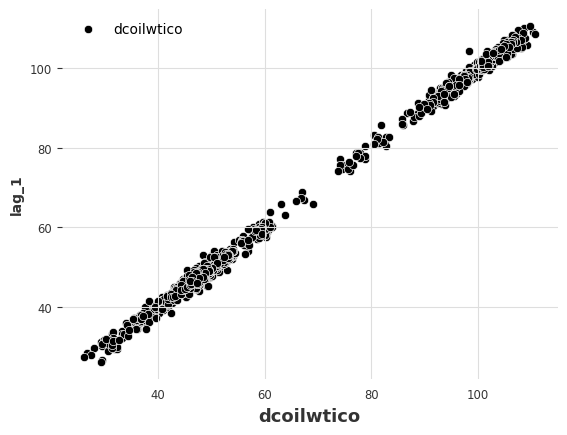

In [30]:
ax=sns.scatterplot(x="dcoilwtico",
                y="lag_1",
                data=oil,
                label="dcoilwtico",
                color="black"
               )

ax.set_xlabel("dcoilwtico",fontsize=13)
plt.legend()
plt.show()

In [31]:
oid_without_missing=oil.dropna()
spearman_correlation,_=spearmanr(oid_without_missing["dcoilwtico"],oid_without_missing["lag_1"])
print(f"the correlation between dcoilwtico anb a 1-step lag feature is :{np.round(spearman_correlation,4)}")

the correlation between dcoilwtico anb a 1-step lag feature is :0.9928


In [32]:
# now I will fill the missing data with the previous data of the column
# i will do that if the 1 step previous value wasn't missing i will take it to fill the blank if not i will continue searching in the prebious values 
# till find not missing values

def fill_oil_previous(data,col):
    try:
        col_copy=data[col].values.tolist()
        length=data[col].shape[0]
        for i in range(length):
            if np.isnan(col_copy[i]):
                index=i-1
                while True:
                    if not np.isnan(col_copy[index]):
                        col_copy[i]=col_copy[index]
                        break
                    index-=1
            else:
                pass
        return col_copy
    except:
        print("There is no column name in the data such the column name you gave us")

liste=fill_oil_previous(oil,"dcoilwtico")

In [33]:
oil["dcoilwtico"]=liste
apply_styling_to_dataframe(oil.head())

,date,dcoilwtico,lag_1
0,2013-01-01 00:00:00,47.260000,nan
1,2013-01-02 00:00:00,93.140000,nan
2,2013-01-03 00:00:00,92.970000,93.140000
3,2013-01-04 00:00:00,93.120000,92.970000
4,2013-01-07 00:00:00,93.200000,93.120000


In [34]:
# not i can drop lag_1 feature
oil.drop("lag_1",axis=1,inplace=True)
apply_styling_to_dataframe(oil.head())

,date,dcoilwtico
0,2013-01-01 00:00:00,47.260000
1,2013-01-02 00:00:00,93.140000
2,2013-01-03 00:00:00,92.970000
3,2013-01-04 00:00:00,93.120000
4,2013-01-07 00:00:00,93.200000


In [35]:
oil.iloc[0,1]=oil.iloc[1,1]

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

<h2 align="left"><font color=#006600>holidays_events.csv
:</font></h2>
 
##### Holidays and Events, with metadata
##### NOTE: Pay special attention to the transferred column. A holiday that is transferred officially falls on that calendar day, but was moved to another date by the government. A transferred day is more like a normal day than a holiday. To find the day that it was actually celebrated, look for the corresponding row where type is Transfer. For example, the holiday Independencia de Guayaquil was transferred from 2012-10-09 to 2012-10-12, which means it was celebrated on 2012-10-12. Days that are type Bridge are extra days that are added to a holiday (e.g., to extend the break across a long weekend). These are frequently made up by the type Work Day which is a day not normally scheduled for work (e.g., Saturday) that is meant to payback the Bridge.
##### Additional holidays are days added a regular calendar holiday, for example, as typically happens around Christmas (making Christmas Eve a holiday).

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

What are our problems?
- Some national holidays have been transferred.
- There might be a few holidays in one day. When we merged all of data, number of rows might increase. We don't want duplicates.
- What is the scope of holidays? It can be regional or national or local. You need to split them by the scope.
- Work day issue
- Some specific events
- Creating new features etc.


In [36]:
#adding holiday data

holiday = pd.DataFrame([])

ecuador_holidays = holi.EC()  # this is a dict
# the below is the same, but takes a string:
ecuador_holidays = holi.country_holidays('EC')  # this is a dict


for date_, name in sorted(holi.EC(years=[2015,2016,2017,2018]).items()):
    holiday = pd.concat([holiday, pd.DataFrame({'ds': date_, 'holiday': "EC-Holidays", 'lower_window': -2, 'upper_window': 1}, index=[0])], ignore_index=True) 

holiday['ds'] = pd.to_datetime(holiday['ds'], format='%Y-%m-%d', errors='ignore')
apply_styling_to_dataframe(holiday.head())

,ds,holiday,lower_window,upper_window
0,2015-01-01 00:00:00,EC-Holidays,-2,1
1,2015-02-16 00:00:00,EC-Holidays,-2,1
2,2015-02-17 00:00:00,EC-Holidays,-2,1
3,2015-04-03 00:00:00,EC-Holidays,-2,1
4,2015-05-01 00:00:00,EC-Holidays,-2,1


In [37]:
apply_styling_to_dataframe(holidays_events.head())

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [38]:
# Additional Holidays
holidays_events["description"] = holidays_events["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
holidays_events["type"] = np.where(holidays_events["type"] == "Additional", "Holiday", holidays_events["type"])

# Bridge Holidays
holidays_events["description"] = holidays_events["description"].str.replace("Puente ", "")
holidays_events["type"] = np.where(holidays_events["type"] == "Bridge", "Holiday", holidays_events["type"])

In [39]:
holidays_events.type.unique()

array(['Holiday', 'Transfer', 'Work Day', 'Event'], dtype=object)

In [40]:
holidays_events[holidays_events.duplicated()]

,date,type,locale,locale_name,description,transferred


In [41]:
holidays_events.drop_duplicates(inplace=True)

In [42]:
holidays_events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350 entries, 0 to 349
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         350 non-null    object
 1   type         350 non-null    object
 2   locale       350 non-null    object
 3   locale_name  350 non-null    object
 4   description  350 non-null    object
 5   transferred  350 non-null    bool  
dtypes: bool(1), object(5)
memory usage: 14.1+ KB


In [43]:
holidays_events["date"]=pd.to_datetime(holidays_events["date"])

In [44]:
# There is a collision,i mean in holidays events table there is a column named type and also in  stores table there is the same name 
holidays_events.rename(columns={"type":"type_holiday"},inplace=True)

In [45]:
# Transferred Holidays
tr2=holidays_events[holidays_events.type_holiday=="Transfer"]
apply_styling_to_dataframe(tr2)

,date,type_holiday,locale,locale_name,description,transferred
20,2012-10-12 00:00:00,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
73,2013-10-11 00:00:00,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
136,2014-10-10 00:00:00,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
256,2016-05-27 00:00:00,Transfer,National,Ecuador,Traslado Batalla de Pichincha,False
265,2016-07-24 00:00:00,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil,False
269,2016-08-12 00:00:00,Transfer,National,Ecuador,Traslado Primer Grito de Independencia,False
298,2017-01-02 00:00:00,Transfer,National,Ecuador,Traslado Primer dia del ano,False
304,2017-04-13 00:00:00,Transfer,Local,Cuenca,Fundacion de Cuenca,False
313,2017-05-26 00:00:00,Transfer,National,Ecuador,Traslado Batalla de Pichincha,False
325,2017-08-11 00:00:00,Transfer,National,Ecuador,Traslado Primer Grito de Independencia,False


In [46]:
# A transferred day is more like a normal day than a holiday
tr1=holidays_events[holidays_events.transferred]
apply_styling_to_dataframe(tr1)

,date,type_holiday,locale,locale_name,description,transferred
19,2012-10-09 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil,True
72,2013-10-09 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil,True
135,2014-10-09 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil,True
255,2016-05-24 00:00:00,Holiday,National,Ecuador,Batalla de Pichincha,True
266,2016-07-25 00:00:00,Holiday,Local,Guayaquil,Fundacion de Guayaquil,True
268,2016-08-10 00:00:00,Holiday,National,Ecuador,Primer Grito de Independencia,True
297,2017-01-01 00:00:00,Holiday,National,Ecuador,Primer dia del ano,True
303,2017-04-12 00:00:00,Holiday,Local,Cuenca,Fundacion de Cuenca,True
312,2017-05-24 00:00:00,Holiday,National,Ecuador,Batalla de Pichincha,True
324,2017-08-10 00:00:00,Holiday,National,Ecuador,Primer Grito de Independencia,True


In [47]:
tr1 = tr1.drop("transferred", axis = 1).reset_index(drop = True)
tr2 = tr2.drop("transferred", axis = 1).reset_index(drop = True)
tr = pd.concat([tr1,tr2], axis = 1)
tr

,date,type_holiday,locale,locale_name,description,date,type_holiday,locale,locale_name,description
0,2012-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2012-10-12,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
1,2013-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2013-10-11,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
2,2014-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2014-10-10,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
3,2016-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2016-05-27,Transfer,National,Ecuador,Traslado Batalla de Pichincha
4,2016-07-25,Holiday,Local,Guayaquil,Fundacion de Guayaquil,2016-07-24,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil
5,2016-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2016-08-12,Transfer,National,Ecuador,Traslado Primer Grito de Independencia
6,2017-01-01,Holiday,National,Ecuador,Primer dia del ano,2017-01-02,Transfer,National,Ecuador,Traslado Primer dia del ano
7,2017-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,2017-04-13,Transfer,Local,Cuenca,Fundacion de Cuenca
8,2017-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2017-05-26,Transfer,National,Ecuador,Traslado Batalla de Pichincha
9,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia


In [48]:
tr = tr.iloc[:, [5,1,2,3,4]]
apply_styling_to_dataframe(tr)

,date,type_holiday,locale,locale_name,description
0,2012-10-12 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil
1,2013-10-11 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil
2,2014-10-10 00:00:00,Holiday,National,Ecuador,Independencia de Guayaquil
3,2016-05-27 00:00:00,Holiday,National,Ecuador,Batalla de Pichincha
4,2016-07-24 00:00:00,Holiday,Local,Guayaquil,Fundacion de Guayaquil
5,2016-08-12 00:00:00,Holiday,National,Ecuador,Primer Grito de Independencia
6,2017-01-02 00:00:00,Holiday,National,Ecuador,Primer dia del ano
7,2017-04-13 00:00:00,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26 00:00:00,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-11 00:00:00,Holiday,National,Ecuador,Primer Grito de Independencia


In [49]:
holidays_events=holidays_events[(holidays_events.transferred == False) & (holidays_events.type_holiday != "Transfer")].drop("transferred", axis = 1)
holidays_events.head().style.set_properties(**{"background-color":"#A2DBFA",
                                                              "color":"black",
                                                              "border":"1.5px solid black"
}).bar(color="#F3F1F5",
       vmin=100_000
      )

,date,type_holiday,locale,locale_name,description
0,2012-03-02 00:00:00,Holiday,Local,Manta,Fundacion de Manta
1,2012-04-01 00:00:00,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi
2,2012-04-12 00:00:00,Holiday,Local,Cuenca,Fundacion de Cuenca
3,2012-04-14 00:00:00,Holiday,Local,Libertad,Cantonizacion de Libertad
4,2012-04-21 00:00:00,Holiday,Local,Riobamba,Cantonizacion de Riobamba


In [50]:
holidays_events = pd.concat([holidays_events,tr],axis=0)
apply_styling_to_dataframe(holidays_events.tail())

,date,type_holiday,locale,locale_name,description
7,2017-04-13 00:00:00,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26 00:00:00,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-11 00:00:00,Holiday,National,Ecuador,Primer Grito de Independencia
10,2017-09-29 00:00:00,Holiday,Local,Ibarra,Fundacion de Ibarra
11,2017-12-08 00:00:00,Holiday,Local,Quito,Fundacion de Quito


In [51]:
# Work Day Holidays, that is meant to payback the Bridge.
work_day = holidays_events[holidays_events.type_holiday == "Work Day"]  
holidays_events = holidays_events[holidays_events.type_holiday != "Work Day"] 
apply_styling_to_dataframe(work_day)

,date,type_holiday,locale,locale_name,description
42,2013-01-05 00:00:00,Work Day,National,Ecuador,Recupero puente Navidad
43,2013-01-12 00:00:00,Work Day,National,Ecuador,Recupero puente primer dia del ano
149,2014-12-20 00:00:00,Work Day,National,Ecuador,Recupero Navidad
161,2015-01-10 00:00:00,Work Day,National,Ecuador,Recupero Primer dia del ano
283,2016-11-12 00:00:00,Work Day,National,Ecuador,Recupero Dia de Difuntos


In [52]:
holidays_events[holidays_events.locale == "National"].locale_name.unique()

array(['Ecuador'], dtype=object)

In [53]:
events = holidays_events[holidays_events.type_holiday == "Event"]
apply_styling_to_dataframe(events.head())

,date,type_holiday,locale,locale_name,description
55,2013-05-12 00:00:00,Event,National,Ecuador,Dia de la Madre
103,2014-05-11 00:00:00,Event,National,Ecuador,Dia de la Madre
106,2014-06-12 00:00:00,Event,National,Ecuador,Inauguracion Mundial de futbol Brasil
107,2014-06-15 00:00:00,Event,National,Ecuador,Mundial de futbol Brasil: EcuadorSuiza
108,2014-06-20 00:00:00,Event,National,Ecuador,Mundial de futbol Brasil: EcuadorHonduras


In [54]:
print(events.type_holiday.unique())
print(events.locale.unique())
print(events.locale_name.unique())

['Event']
['National']
['Ecuador']


In [55]:
# Split

# Events are national
events = holidays_events[holidays_events.type_holiday == "Event"].drop(["type_holiday", "locale", "locale_name"], axis = 1).rename({"description":"events"}, axis = 1)
events["events"] =np.where(events.events.str.contains("futbol"), "Futbol", events.events)

holidays_events = holidays_events[holidays_events.type_holiday != "Event"].drop("type_holiday", axis = 1)
regional = holidays_events[holidays_events.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
national = holidays_events[holidays_events.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
local = holidays_events[holidays_events.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()

In [56]:
apply_styling_to_dataframe(local.head())

,date,city,holiday_local
0,2012-03-02 00:00:00,Manta,Fundacion de Manta
2,2012-04-12 00:00:00,Cuenca,Fundacion de Cuenca
3,2012-04-14 00:00:00,Libertad,Cantonizacion de Libertad
4,2012-04-21 00:00:00,Riobamba,Cantonizacion de Riobamba
5,2012-05-12 00:00:00,Puyo,Cantonizacion del Puyo


In [57]:
apply_styling_to_dataframe(national.tail())

,date,holiday_national
3,2016-05-27 00:00:00,Batalla de Pichincha
5,2016-08-12 00:00:00,Primer Grito de Independencia
6,2017-01-02 00:00:00,Primer dia del ano
8,2017-05-26 00:00:00,Batalla de Pichincha
9,2017-08-11 00:00:00,Primer Grito de Independencia


In [58]:
apply_styling_to_dataframe(regional.head())

,date,state,holiday_regional
1,2012-04-01 00:00:00,Cotopaxi,Provincializacion de Cotopaxi
7,2012-06-25 00:00:00,Imbabura,Provincializacion de Imbabura
23,2012-11-06 00:00:00,Santo Domingo de los Tsachilas,Provincializacion de Santo Domingo
24,2012-11-07 00:00:00,Santa Elena,Provincializacion Santa Elena
47,2013-04-01 00:00:00,Cotopaxi,Provincializacion de Cotopaxi


In [59]:
# National Holidays & Events
#d = pd.merge(holidays_events, events, how = "left")
holidays_events = pd.merge(holidays_events, national, how = "left")
# Regional
holidays_events = pd.merge(holidays_events, regional, how = "left")
# Local
holidays_events = pd.merge(holidays_events, local, how = "left")

# Work Day: It will be removed when real work day colum created
holidays_events = pd.merge(holidays_events,  work_day[["date", "type_holiday"]].rename(columns={"type_holiday":"IsWorkDay"}),how = "left")

In [60]:
holidays_events.drop(["locale","locale_name","description"],axis=1,inplace=True)
apply_styling_to_dataframe(holidays_events.head())

,date,holiday_national,state,holiday_regional,city,holiday_local,IsWorkDay
0,2012-03-02 00:00:00,nan,nan,nan,Manta,Fundacion de Manta,nan
1,2012-04-01 00:00:00,nan,Cotopaxi,Provincializacion de Cotopaxi,nan,nan,nan
2,2012-04-12 00:00:00,nan,nan,nan,Cuenca,Fundacion de Cuenca,nan
3,2012-04-14 00:00:00,nan,nan,nan,Libertad,Cantonizacion de Libertad,nan
4,2012-04-21 00:00:00,nan,nan,nan,Riobamba,Cantonizacion de Riobamba,nan


In [61]:
transactions=transactions.sort_values(by=["date","store_nbr"],ascending=[True,True])
apply_styling_to_dataframe(transactions.tail())

,date,store_nbr,transactions
83483,2017-08-15,50,2804
83484,2017-08-15,51,1573
83485,2017-08-15,52,2255
83486,2017-08-15,53,932
83487,2017-08-15,54,802


In [62]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83488 entries, 0 to 83487
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   date          83488 non-null  object
 1   store_nbr     83488 non-null  int64 
 2   transactions  83488 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 1.9+ MB


In [63]:
transactions["date"]=pd.to_datetime(transactions["date"])

<a id="libraries"></a>
# <b><span style='color:#c78a44'> Merging the train data</span></b>

In [64]:
train_set=train.merge(stores,how="left")
apply_styling_to_dataframe(train_set.head())

,id,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster
0,1700028,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,Saturday,August,6,Quito,Pichincha,D,13
1,1700029,2015-08-15 00:00:00,1,BABY CARE,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13
2,1700030,2015-08-15 00:00:00,1,BEAUTY,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13
3,1700031,2015-08-15 00:00:00,1,BEVERAGES,2845.000000,5,Saturday,August,6,Quito,Pichincha,D,13
4,1700032,2015-08-15 00:00:00,1,BOOKS,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13


In [65]:
print(train_set.shape)

(1300860, 13)


In [66]:
# National Holidays & Events
train_set = pd.merge(train_set, national, how = "left")
# Regional
train_set = pd.merge(train_set, regional, how = "left", on = ["date", "state"])
# Local
train_set = pd.merge(train_set, local, how = "left",on = ["date", "city"])

# Work Day: It will be removed when real work day colum created
train_set = pd.merge(train_set,  work_day[["date", "type_holiday"]].rename(columns={"type_holiday":"IsWorkDay"}),how = "left")

In [67]:
train_set=train_set.merge(oil,how="left")
apply_styling_to_dataframe(train_set.head())

,id,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico
0,1700028,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan
1,1700029,2015-08-15 00:00:00,1,BABY CARE,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan
2,1700030,2015-08-15 00:00:00,1,BEAUTY,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan
3,1700031,2015-08-15 00:00:00,1,BEVERAGES,2845.000000,5,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan
4,1700032,2015-08-15 00:00:00,1,BOOKS,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan


In [68]:
print(train_set.shape)

(1301124, 18)


In [69]:
train_set=train_set.merge(transactions,how="left")
apply_styling_to_dataframe(train_set.head())

,id,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico,transactions
0,1700028,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan,1379.000000
1,1700029,2015-08-15 00:00:00,1,BABY CARE,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan,1379.000000
2,1700030,2015-08-15 00:00:00,1,BEAUTY,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan,1379.000000
3,1700031,2015-08-15 00:00:00,1,BEVERAGES,2845.000000,5,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan,1379.000000
4,1700032,2015-08-15 00:00:00,1,BOOKS,0.000000,0,Saturday,August,6,Quito,Pichincha,D,13,nan,nan,nan,nan,nan,1379.000000


<a id="libraries"></a>
# <b><span style='color:#c78a44'> Merging the test data</span></b>

In [70]:
test_set=test.merge(stores,how="left")
apply_styling_to_dataframe(test_set.head())

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster
0,3000888,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3,Quito,Pichincha,D,13
1,3000889,2017-08-16 00:00:00,1,BABY CARE,0,Wednesday,August,3,Quito,Pichincha,D,13
2,3000890,2017-08-16 00:00:00,1,BEAUTY,2,Wednesday,August,3,Quito,Pichincha,D,13
3,3000891,2017-08-16 00:00:00,1,BEVERAGES,20,Wednesday,August,3,Quito,Pichincha,D,13
4,3000892,2017-08-16 00:00:00,1,BOOKS,0,Wednesday,August,3,Quito,Pichincha,D,13


In [71]:
# National Holidays & Events
test_set = pd.merge(test_set, national, how = "left")
# Regional
test_set = pd.merge(test_set, regional, how = "left", on = ["date", "state"])
# Local
test_set = pd.merge(test_set, local, how = "left",on = ["date", "city"])

# Work Day: It will be removed when real work day colum created
test_set = pd.merge(test_set,  work_day[["date", "type_holiday"]].rename(columns={"type_holiday":"IsWorkDay"}),how = "left")
apply_styling_to_dataframe(test_set.head())

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay
0,3000888,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan
1,3000889,2017-08-16 00:00:00,1,BABY CARE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan
2,3000890,2017-08-16 00:00:00,1,BEAUTY,2,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan
3,3000891,2017-08-16 00:00:00,1,BEVERAGES,20,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan
4,3000892,2017-08-16 00:00:00,1,BOOKS,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan


In [72]:
test_set=test_set.merge(oil,how="left")
apply_styling_to_dataframe(test_set.head())

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico
0,3000888,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000
1,3000889,2017-08-16 00:00:00,1,BABY CARE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000
2,3000890,2017-08-16 00:00:00,1,BEAUTY,2,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000
3,3000891,2017-08-16 00:00:00,1,BEVERAGES,20,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000
4,3000892,2017-08-16 00:00:00,1,BOOKS,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000


In [73]:
test_set=test_set.merge(transactions,how="left")
apply_styling_to_dataframe(test_set.head())

,id,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico,transactions
0,3000888,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000,nan
1,3000889,2017-08-16 00:00:00,1,BABY CARE,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000,nan
2,3000890,2017-08-16 00:00:00,1,BEAUTY,2,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000,nan
3,3000891,2017-08-16 00:00:00,1,BEVERAGES,20,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000,nan
4,3000892,2017-08-16 00:00:00,1,BOOKS,0,Wednesday,August,3,Quito,Pichincha,D,13,nan,nan,nan,nan,46.800000,nan


<a id="libraries"></a>
# <b><span style='color:#c78a44'> data cleaning</span></b>

<center><img src="https://as1.ftcdn.net/v2/jpg/04/00/74/18/1000_F_400741848_rmWpSeKcco4BiZHxe9Gu3AaE1t1NMe74.jpg" width="400" height="100" /><center>

<center><img src="https://assets-global.website-files.com/5ee50f2ef83ac07f0cb7fb44/63efb06e03683571125ba9af_unnamed%20(21).jpg" width="400" height="100" /></center>

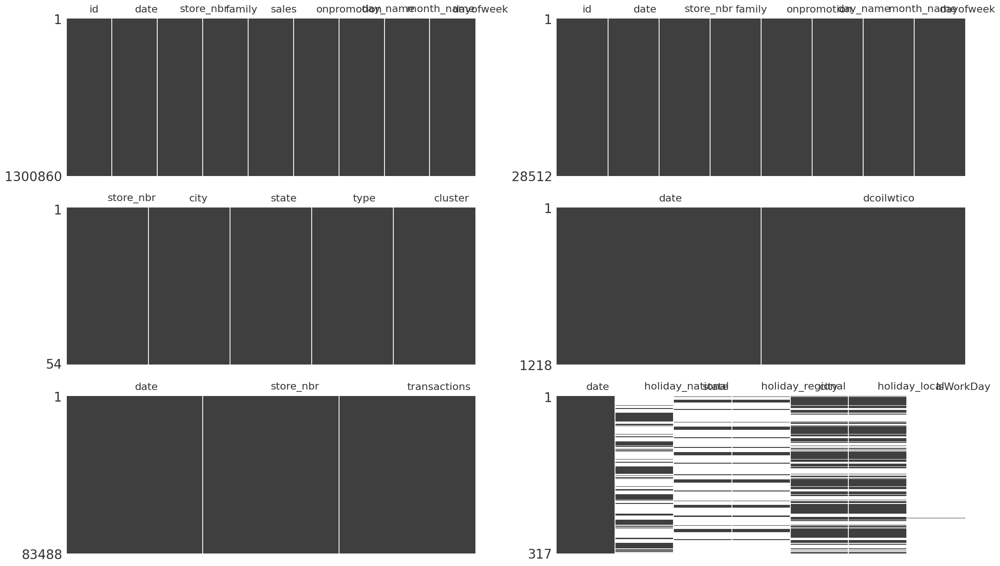

In [74]:
list_data_sets=[train,test,stores,oil,transactions,holidays_events]
fig, axes = plt.subplots(len(list_data_sets) // 2, 2,figsize=(25,15))
index = 0
for i in range(len(list_data_sets) // 2):
    for j in range(2):
        msno.matrix(list_data_sets[index], ax=axes[i, j], label_rotation=0)
        index += 1
plt.show()

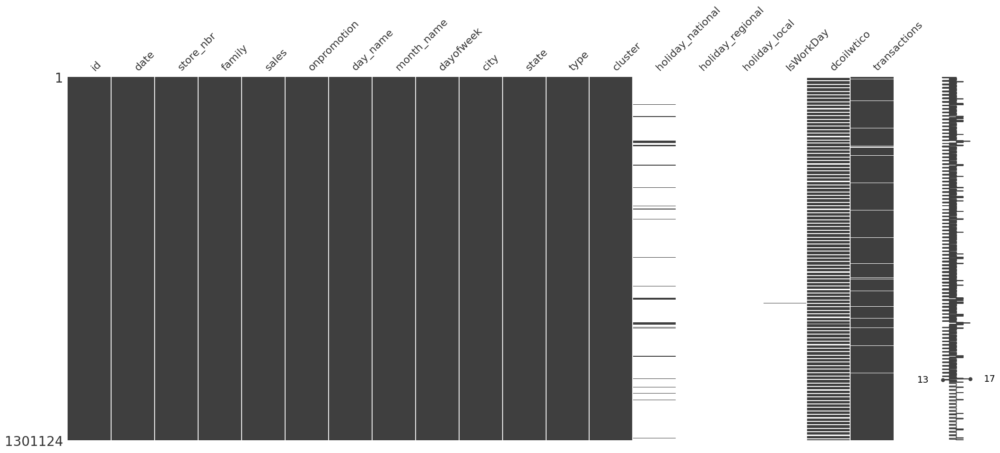

In [75]:
msno.matrix(train_set)
plt.show()

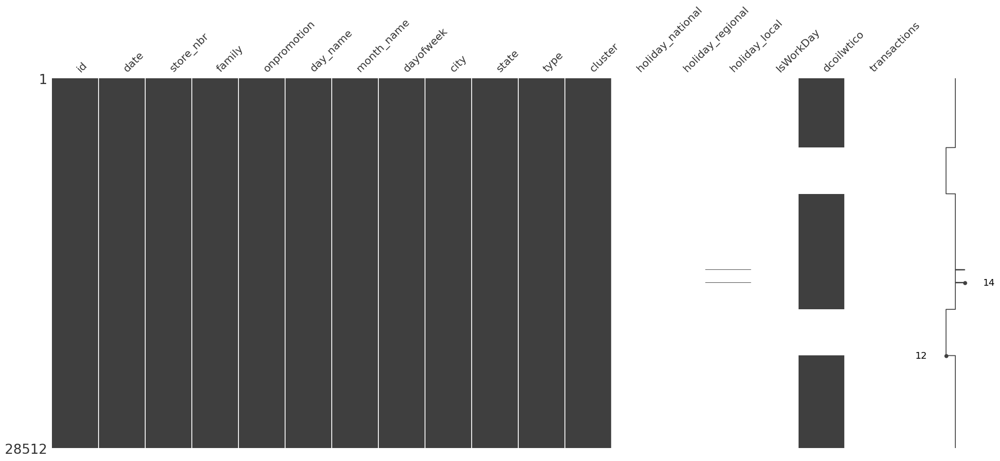

In [76]:
msno.matrix(test_set)
plt.show()

In [77]:
train_set.drop(["id"],axis=1,inplace=True)
test_set.drop(["id"],axis=1,inplace=True)

In [78]:
liste=fill_oil_previous(train_set,"dcoilwtico")
print("finding the previous values of dcoilwtico column is done")

finding the previous values of dcoilwtico column is done


In [79]:
train_set["dcoilwtico"]=liste

In [80]:
liste=fill_oil_previous(test_set,"dcoilwtico")
print("finding the previous values of dcoilwtico column is done")

finding the previous values of dcoilwtico column is done


In [81]:
test_set["dcoilwtico"]=liste

In [82]:
train_set.columns

Index(['date', 'store_nbr', 'family', 'sales', 'onpromotion', 'day_name',
       'month_name', 'dayofweek', 'city', 'state', 'type', 'cluster',
       'holiday_national', 'holiday_regional', 'holiday_local', 'IsWorkDay',
       'dcoilwtico', 'transactions'],
      dtype='object')

In [83]:
train_set.drop(["holiday_national","holiday_regional","holiday_local","IsWorkDay"],axis=1,inplace=True)
test_set.drop(["holiday_national","holiday_regional","holiday_local","IsWorkDay"],axis=1,inplace=True)

<a id="libraries"></a>
# <b><span style='color:#c78a44'>Exploratory Data Analysis(EDA)</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">
    
EDA (Exploratory Data Analysis) in simple words is like being a detective for data. It's the process of examining and understanding a dataset before you start building models or making decisions based on the data.

EDA is like exploring a new place, looking for clues, and making sense of what you find before making any important decisions. It's a crucial step in the data analysis process.

# Oil Price

In [84]:
oil["year"]=oil.date.dt.year
apply_styling_to_dataframe(oil.head())

,date,dcoilwtico,year
0,2013-01-01 00:00:00,93.140000,2013
1,2013-01-02 00:00:00,93.140000,2013
2,2013-01-03 00:00:00,92.970000,2013
3,2013-01-04 00:00:00,93.120000,2013
4,2013-01-07 00:00:00,93.200000,2013


In [85]:
px.line(data_frame=oil,
        x="date",
        y="dcoilwtico",
        color="year"
       )

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

**I just said, "Ecuador is a oil-dependent country" but is it true? Can we really see that from the data by looking at?**

First of all, let's look at the correlations for sales and transactions. The correlation values are not strong but the sign of sales is negative. Maybe, we can catch a clue. Logically, if daily oil price is high, we expect that the Ecuador's economy is bad and it means the price of product increases and sales decreases. There is a negative relationship here.  

Correlation with Daily Oil Prices
sales          0.06
transactions   0.01
Name: dcoilwtico, dtype: float64 



Text(0.5, 1.0, 'Daily Oil Price & Sales')

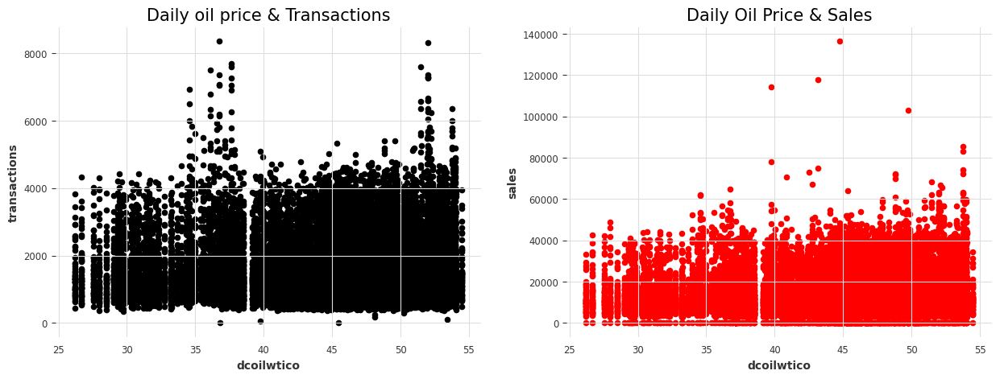

In [86]:
temp = pd.merge(train.groupby(["date","store_nbr"]).sales.sum().reset_index(), 
                transactions,
                how = "left"
               )
temp = pd.merge(temp, oil, how = "left")
print("Correlation with Daily Oil Prices")
print(temp[["sales","dcoilwtico","transactions"]].corr("spearman").dcoilwtico.loc[["sales", "transactions"]], "\n")

fig, axes = plt.subplots(1, 2, figsize = (15,5))
temp.plot.scatter(x = "dcoilwtico", y = "transactions", ax=axes[0])
temp.plot.scatter(x = "dcoilwtico", y = "sales", ax=axes[1], color = "r")
axes[0].set_title('Daily oil price & Transactions', fontsize = 15)
axes[1].set_title('Daily Oil Price & Sales', fontsize = 15)

<div style="border-radius:10px; padding: 15px; background-color: #d8b26e; font-size:130%; text-align:left">

You should never decide what you will do by looking at a graph or result! You are supposed to change your view and define new hypotheses.

We would have been wrong if we had looked at some simple outputs just like above and we had said that there is no relationship with oil prices and let's not use oil price data.

All right! We are aware of analyzing deeply now. Let's draw a scatter plot but let's pay attention for product families this time. All of the plots almost contains same pattern. When daily oil price is under about 70, there are more sales in the data. There are 2 cluster here. They are over 70 and under 70. It seems pretty understandable actually.

We are in a good way I think. What do you think? Just now, we couldn't see a pattern for daily oil price, but now we extracted a new pattern from it.

In [ ]:
a = pd.merge(train.groupby(["date", "family"]).sales.sum().reset_index(), oil.drop("year", axis = 1), how = "left")
c = a.groupby("family").corr("spearman").reset_index() # the correlation for each family
c = c[c.level_1 == "dcoilwtico"][["family", "sales"]].sort_values("sales")

fig, axes = plt.subplots(7, 5, figsize = (20,20))
families=c.family.values.tolist()
counter=0
for i in range(7):
    for j in range(5):
        if counter<len(families):
            a[a.family==families[counter]].plot.scatter(x = "dcoilwtico", y = "sales", ax=axes[i, j])
            axes[i, j].set_title(families[counter]+"\n Correlation:"+str(c[c.family == families[counter]].sales.iloc[0])[:6], fontsize = 12)
            axes[i, j].axvline(x=70, color='r', linestyle='--') 
            counter+=1
0     
        
plt.tight_layout(pad=5)
plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize = 20);
plt.show()
        

In [88]:
numerical_describe = train_set.describe(include=[np.number]).T
numerical_describe

,count,mean,std,min,25%,50%,75%,max
store_nbr,1301124.00,27.50,15.58,1.00,14.00,28.00,41.00,54.00
sales,1301124.00,455.45,1308.82,0.00,2.00,24.00,262.00,124717.00
onpromotion,1301124.00,5.26,17.17,0.00,0.00,0.00,2.00,741.00
dayofweek,1301124.00,4.00,2.00,1.00,2.00,4.00,6.00,7.00
cluster,1301124.00,8.48,4.65,1.00,4.00,8.50,13.00,17.00
dcoilwtico,1301124.00,45.08,6.11,26.19,42.16,46.02,49.34,54.48
transactions,1265781.00,1651.73,953.66,5.00,1013.00,1359.00,1985.00,8359.00


In [89]:
categorical_describe = train_set.describe(exclude=[np.number]).T
categorical_describe

,count,unique,top,freq,mean,min,25%,50%,75%,max
date,1301124,NaN,NaN,NaN,2016-08-14 15:12:54.637313280,2015-08-15 00:00:00,2016-02-14 00:00:00,2016-08-14 00:00:00,2017-02-14 00:00:00,2017-08-15 00:00:00
family,1301124,33,AUTOMOTIVE,39428,NaN,NaN,NaN,NaN,NaN,NaN
day_name,1301124,7,Saturday,187110,NaN,NaN,NaN,NaN,NaN,NaN
month_name,1301124,12,August,112266,NaN,NaN,NaN,NaN,NaN,NaN
city,1301124,22,Quito,433620,NaN,NaN,NaN,NaN,NaN,NaN
state,1301124,16,Pichincha,457710,NaN,NaN,NaN,NaN,NaN,NaN
type,1301124,5,D,433686,NaN,NaN,NaN,NaN,NaN,NaN


In [90]:
apply_styling_to_dataframe(stores.head())

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [91]:
# there are 54 stores
stores.shape

(54, 5)

In [92]:
#the data is unbalanced
# the are 18 store in quito city
stores["city"].value_counts()

city
Quito            18
Guayaquil         8
Cuenca            3
Santo Domingo     3
Latacunga         2
Machala           2
Manta             2
Ambato            2
Cayambe           1
Riobamba          1
Ibarra            1
Salinas           1
Puyo              1
Guaranda          1
Quevedo           1
Babahoyo          1
Daule             1
Playas            1
Loja              1
Libertad          1
Esmeraldas        1
El Carmen         1
Name: count, dtype: int64

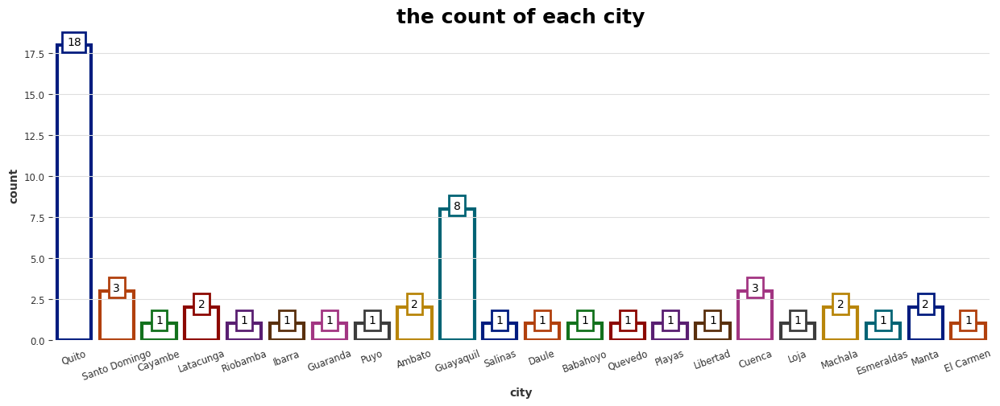

In [93]:
palette_color=sns.color_palette("dark")
plt.figure(figsize=(15,5))
ax=sns.countplot(x="city",
                 data=stores,
                 facecolor=(0,0,0,0),
                 linewidth=3,
                 edgecolor=palette_color
                )

plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=18,
    titlepad=7,
)

c=0
for p in ax.patches:
    count=int(p.get_height())
    index=(p.get_x()+p.get_width()/2.,p.get_height())
    ax.annotate(count,
                index,
                ha="center",
                bbox=dict(facecolor="white",edgecolor=palette_color[c],linewidth=2)
               )
    c+=1
    c=c%len(palette_color)

ax.set_xticklabels(ax.get_xticklabels(),
                   rotation=20
                   )
ax.set_title("the count of each city")
plt.show()

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
variation ratio of city feature

In [94]:
frequency_table_city=stores["city"].value_counts()
frequency_table_city_values=frequency_table_city.values
majority_city=frequency_table_city_values.max()
n=frequency_table_city_values.sum()
print(f"the count of the most frequent  value in city feature is: {majority_city}")
print(f"the count of all values in city feature is: {n}")
variation_ratio_city=np.round(1-majority_city/n,4)
print(f"the variation ratio of city column is: {variation_ratio_city}")

the count of the most frequent  value in city feature is: 18
the count of all values in city feature is: 54
the variation ratio of city column is: 0.6667


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
calculate anova between city and the target(sales)

In [95]:
city_sales =train_set.groupby(["city"]).sales.sum().reset_index()
apply_styling_to_dataframe(city_sales)

,city,sales
0,Ambato,20787305.794441
1,Babahoyo,9519506.795133
2,Cayambe,14313036.237290
3,Cuenca,30140964.139516
4,Daule,10643924.370140
5,El Carmen,6070455.226143
6,Esmeraldas,8908400.787344
7,Guaranda,6822155.366038
8,Guayaquil,68030253.603285
9,Ibarra,5888531.279708


In [96]:
mod=ols("sales ~ city",data=train_set).fit()
anova_table_city=sm.stats.anova_lm(mod,typ=2)
anova_table_city


,sum_sq,df,F,PR(>F)
city,46376675351.61,21.00,1316.57,0.00
Residual,2182466244976.69,1301102.00,NaN,NaN


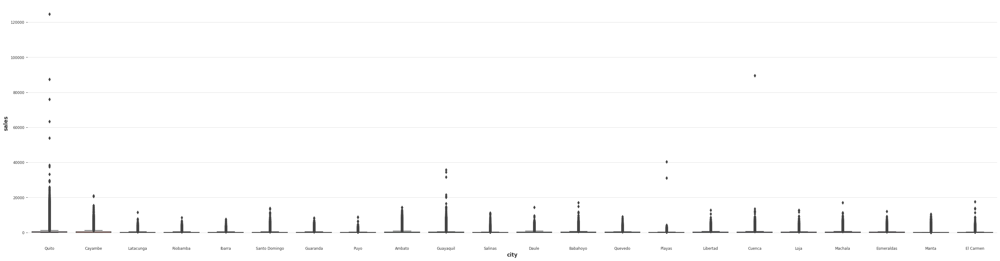

In [97]:
plt.figure(figsize=(40,10))
sns.boxplot(x="city",y="sales",data=train_set)
plt.show()

In [98]:
train_set["year"] = train_set.date.dt.year
a=train_set.groupby(["city","year"],as_index=False).sales.mean()

plot=px.line(data_frame=a,
        x="year",
        y="sales",
        color="city",
        title="yearly average sales for each city"
       )
train_set.drop(["year"],axis=1,inplace=True)
plot

In [ ]:
a=train_set.groupby(["city","date"],as_index=False).agg(city_sales=("sales","mean"))
px.line(data_frame=a,
        x="date",
        y="city_sales",
        color="city",
        title="daily total sales for each city"
       )


In [ ]:
number_of_cities = train_set.city.nunique()
cities = train_set.city.unique()
number_of_rows = ceil(number_of_cities/ 3)
c = 0
palette=sns.color_palette("dark")
a=train_set.groupby(["city","date"],as_index=False).agg(city_sales=("sales","mean"))
fig, axes = plt.subplots(nrows=number_of_rows, 
                         ncols=1, 
                         sharex=False,
                         figsize=(15, 5*number_of_rows)
                        )

for i, ax in enumerate(axes.flatten()):
    try:
        arr = cities[c:c+3]
    except:
        arr = cities[c:]
    c += 3
    df=a.query("city in @arr")
    sns.lineplot(data=df,
                 x="date",
                 y="city_sales", 
                 hue="city", 
                 ax=ax,
                 palette=palette
                )
    ax.set_title("Daily total sales of each city")
    ax.legend(title='city',
              loc='upper left'
             )

plt.tight_layout()
plt.show()


In [ ]:
h=a[a.city.isin(["El Carmen","Guaranda"])]
px.line(data_frame=h,
        x="date",
        y="city_sales",
        color="city",
        title="daily total sales for each city"
       )

In [ ]:
# the data is unbalanced
stores["state"].value_counts()

state
Pichincha                         19
Guayas                            11
Azuay                              3
Santo Domingo de los Tsachilas     3
Manabi                             3
Los Rios                           2
Cotopaxi                           2
Tungurahua                         2
El Oro                             2
Bolivar                            1
Imbabura                           1
Chimborazo                         1
Pastaza                            1
Santa Elena                        1
Loja                               1
Esmeraldas                         1
Name: count, dtype: int64

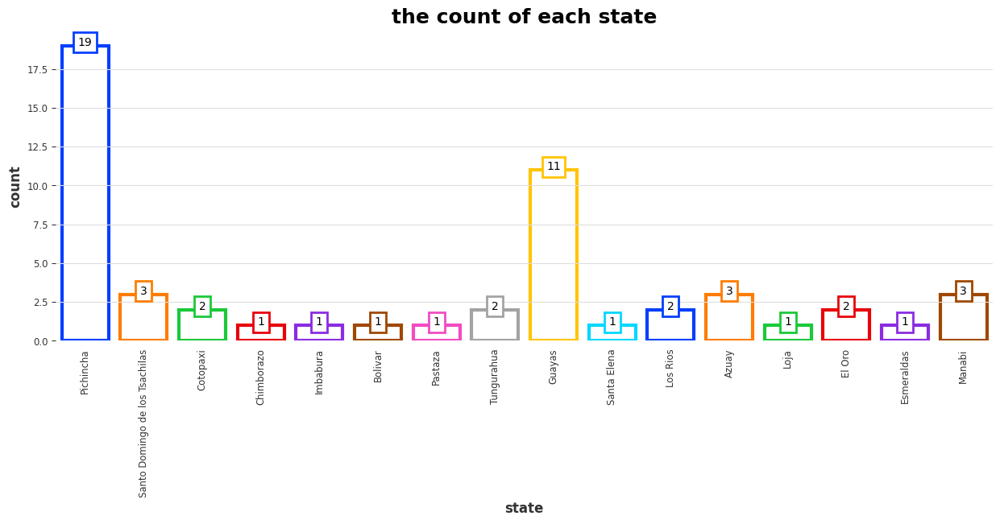

In [ ]:
palette_color=sns.color_palette("bright")
plt.figure(figsize=(15,5))
ax=sns.countplot(x="state",
                 data=stores,
                 facecolor=(0,0,0,0),
                 linewidth=3,
                 edgecolor=palette_color
                )

plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=18,
    titlepad=7,
)

c=0
for p in ax.patches:
    count=int(p.get_height())
    index=(p.get_x()+p.get_width()/2.,p.get_height())
    ax.annotate(count,
                index,
                ha="center",
                bbox=dict(facecolor="white",edgecolor=palette_color[c],linewidth=2)
               )
    c+=1
    c=c%len(palette_color)

ax.set_xticklabels(ax.get_xticklabels(),
                   rotation=90
                   )
ax.set_title("the count of each state")
plt.show()

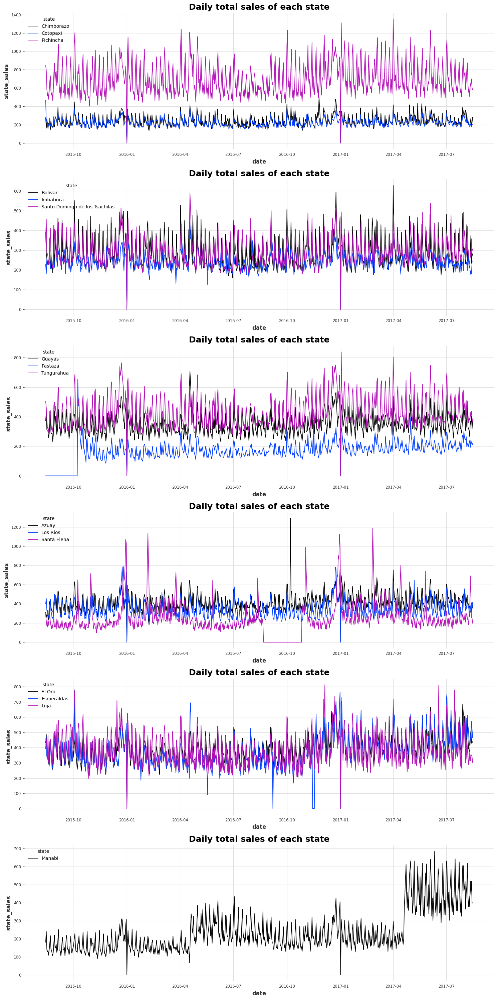

In [104]:
number_of_states= train_set.state.nunique()
states = train_set.state.unique()
number_of_rows = ceil(number_of_states/ 3)
c = 0
palette=sns.color_palette()
a=train_set.groupby(["state","date"],as_index=False).agg(state_sales=("sales","mean"))
fig, axes = plt.subplots(nrows=number_of_rows, 
                         ncols=1, 
                         sharex=False,
                         figsize=(15, 5*number_of_rows)
                        )

for i, ax in enumerate(axes.flatten()):
    try:
        arr = states[c:c+3]
    except:
        arr = states[c:]
    c += 3
    df=a.query("state in @arr")
    sns.lineplot(data=df,
                 x="date",
                 y="state_sales", 
                 hue="state", 
                 ax=ax,
                 palette=palette
                )
    ax.set_title("Daily total sales of each state")
    ax.legend(title='state',
              loc='upper left'
             )

plt.tight_layout()
plt.show()


In [105]:
h=a[a.state.isin(["Pichincha","Guayas","Tungurahua","Bolivar"])]
px.line(data_frame=h,
        x="date",
        y="state_sales",
        color="state",
        title="daily total sales for each state"
       )

In [106]:
train_set["year"] = train_set.date.dt.year
a=train_set.groupby(["state","year"],as_index=False).sales.mean()

plot=px.line(data_frame=a,
        x="year",
        y="sales",
        color="state",
        title="daily total sales each state"
       )
train_set.drop(["year"],axis=1,inplace=True)
plot

In [107]:
a=train_set.groupby(["type","date"],as_index=False).agg(type_sales=("sales","mean"))
px.line(data_frame=a,
        x="date",
        y="type_sales",
        color="type",
        title="daily total sales for each type"
       )


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
variation ratio of state feature

In [108]:
frequency_table_state=stores["state"].value_counts()
frequency_table_state_values=frequency_table_state.values
majority_state=frequency_table_state_values.max()
n=frequency_table_state_values.sum()
print(f"the count of the most frequent  value in state feature is: {majority_state}")
print(f"the count of all values in state feature is: {n}")
variation_ratio_state=np.round(1-majority_state/n,4)
print(f"the variation ratio of state column is: {variation_ratio_state}")

the count of the most frequent  value in state feature is: 19
the count of all values in state feature is: 54
the variation ratio of state column is: 0.6481


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
grouping the mean of the sales according to state and city

In [109]:
group_state_city=train_set.groupby(["state","city"],as_index=False)["sales"].agg(
    {"sales_mean":"mean",
     "sales_count":"count",
     "sales_sum":"sum"
    }
).sort_values(by=["sales_mean","sales_count"],ascending=[False,False])

apply_styling_to_dataframe(group_state_city)

,state,city,sales_mean,sales_count,sales_sum
18,Pichincha,Quito,702.423839,433620,304585025.011989
17,Pichincha,Cayambe,594.148453,24090,14313036.237290
6,Guayas,Daule,441.839949,24090,10643924.370140
21,Tungurahua,Ambato,431.450930,48180,20787305.794441
0,Azuay,Cuenca,417.060525,72270,30140964.139516
12,Los Rios,Babahoyo,395.164251,24090,9519506.795133
4,El Oro,Machala,391.616315,48180,18868074.073738
11,Loja,Loja,387.574343,24090,9336665.933328
5,Esmeraldas,Esmeraldas,369.796629,24090,8908400.787344
8,Guayas,Libertad,369.604396,24090,8903769.898176


In [110]:
pivot_state_city = group_state_city[["state","city","sales_mean"]].pivot(index='state',
                                                columns='city')
                                                            
pivot_state_city

sales_mean                                 \
city                               Ambato Babahoyo Cayambe Cuenca  Daule   
state                                                                      
Azuay                                 NaN      NaN     NaN 417.06    NaN   
Bolivar                               NaN      NaN     NaN    NaN    NaN   
Chimborazo                            NaN      NaN     NaN    NaN    NaN   
Cotopaxi                              NaN      NaN     NaN    NaN    NaN   
El Oro                                NaN      NaN     NaN    NaN    NaN   
Esmeraldas                            NaN      NaN     NaN    NaN    NaN   
Guayas                                NaN      NaN     NaN    NaN 441.84   
Imbabura                              NaN      NaN     NaN    NaN    NaN   
Loja                                  NaN      NaN     NaN    NaN    NaN   
Los Rios                              NaN   395.16     NaN    NaN    NaN   
Manabi                                NaN      NaN     NaN    NaN    NaN   
Pastaza                               NaN      NaN     NaN    NaN    NaN   
Pichincha                             NaN      NaN  594.15    NaN    NaN   
Santa Elena                           NaN      NaN     NaN    NaN    NaN   
Santo Domingo de los Tsachilas        NaN      NaN     NaN    NaN    NaN   
Tungurahua                         431.45      NaN     NaN    NaN    NaN   

                                                                               \
city                           El Carmen Esmeraldas Guaranda Guayaquil Ibarra   
state                                                                           
Azuay                                NaN        NaN      NaN       NaN    NaN   
Bolivar                              NaN        NaN   283.19       NaN    NaN   
Chimborazo                           NaN        NaN      NaN       NaN    NaN   
Cotopaxi                             NaN        NaN      NaN       NaN    NaN   
El Oro                               NaN        NaN      NaN       NaN    NaN   
Esmeraldas                           NaN     369.80      NaN       NaN    NaN   
Guayas                               NaN        NaN      NaN    352.52    NaN   
Imbabura                             NaN        NaN      NaN       NaN 244.44   
Loja                                 NaN        NaN      NaN       NaN    NaN   
Los Rios                             NaN        NaN      NaN       NaN    NaN   
Manabi                            251.99        NaN      NaN       NaN    NaN   
Pastaza                              NaN        NaN      NaN       NaN    NaN   
Pichincha                            NaN        NaN      NaN       NaN    NaN   
Santa Elena                          NaN        NaN      NaN       NaN    NaN   
Santo Domingo de los Tsachilas       NaN        NaN      NaN       NaN    NaN   
Tungurahua                           NaN        NaN      NaN       NaN    NaN   

                                                                         \
city                           Latacunga Libertad   Loja Machala  Manta   
state                                                                     
Azuay                                NaN      NaN    NaN     NaN    NaN   
Bolivar                              NaN      NaN    NaN     NaN    NaN   
Chimborazo                           NaN      NaN    NaN     NaN    NaN   
Cotopaxi                          223.19      NaN    NaN     NaN    NaN   
El Oro                               NaN      NaN    NaN  391.62    NaN   
Esmeraldas                           NaN      NaN    NaN     NaN    NaN   
Guayas                               NaN   369.60    NaN     NaN    NaN   
Imbabura                             NaN      NaN    NaN     NaN    NaN   
Loja                                 NaN      NaN 387.57     NaN    NaN   
Los Rios                             NaN      NaN    NaN     NaN    NaN   
Manabi                               NaN      NaN    NaN     NaN 231.45

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
calculate anova between state and the target(sales)

In [111]:
mod=ols("sales ~ state",data=train_set).fit()
anova_table_state=sm.stats.anova_lm(mod,typ=2)
anova_table_state

,sum_sq,df,F,PR(>F)
state,44997900381.65,15.00,1787.28,0.00
Residual,2183845019946.65,1301108.00,NaN,NaN


In [112]:
stores["type"].value_counts()

type
D    18
C    15
A     9
B     8
E     4
Name: count, dtype: int64

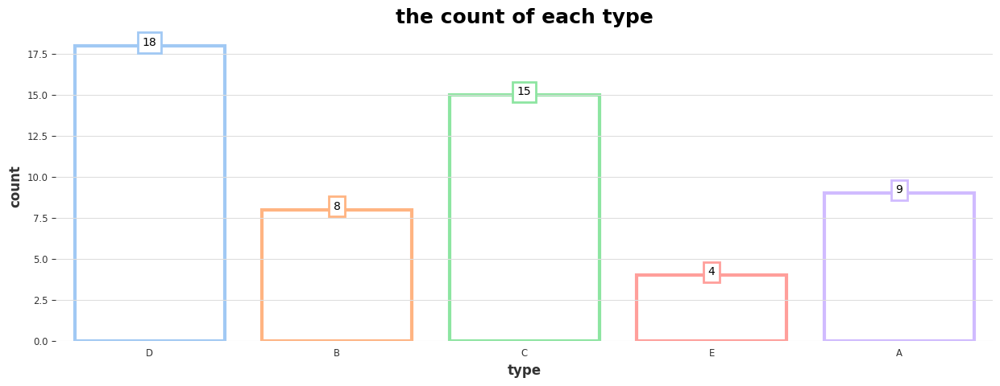

In [113]:
palette_color=sns.color_palette("pastel")
plt.figure(figsize=(15,5))
ax=sns.countplot(x="type",
                 data=stores,
                 facecolor=(0,0,0,0),
                 linewidth=3,
                 edgecolor=palette_color
                )

plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=18,
    titlepad=7,
)
c=0
for p in ax.patches:
    count=int(p.get_height())
    index=(p.get_x()+p.get_width()/2.,p.get_height())
    ax.annotate(count,
                index,
                ha="center",
                bbox=dict(facecolor="white",edgecolor=palette_color[c],linewidth=2)
               )
    c+=1


ax.set_title("the count of each type")
plt.show()

In [114]:
train_set["year"] = train_set.date.dt.year
a=train_set.groupby(["type","year"],as_index=False).sales.mean()

plot=px.line(data_frame=a,
        x="year",
        y="sales",
        color="type",
        title="daily total sales each type"
       )
train_set.drop(["year"],axis=1,inplace=True)
plot

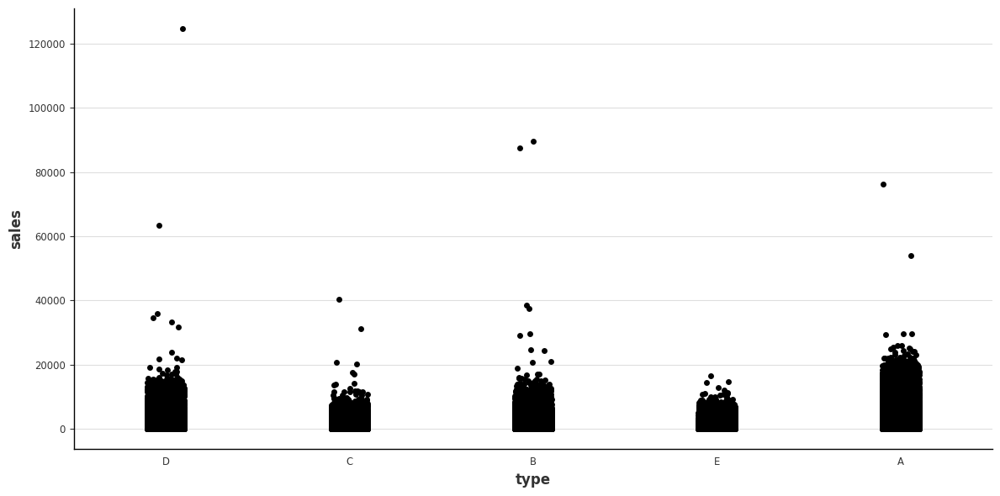

In [115]:
sns.catplot(data=train_set,
            x="type",
            y="sales",
            height=6,
            aspect=2
           )

plt.show()

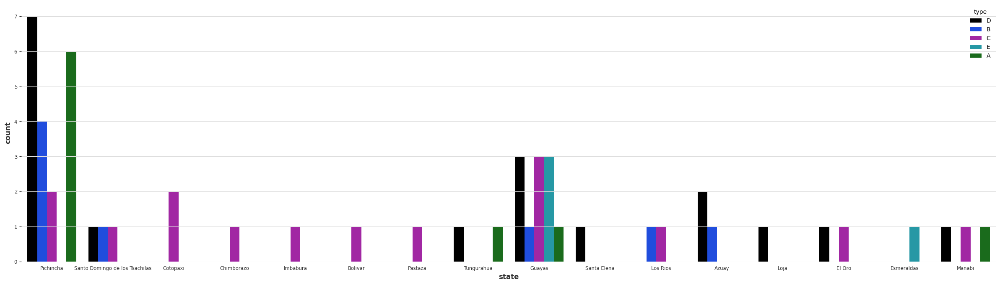

In [116]:
plt.figure(figsize=(30,8))
ax=sns.countplot(x="state",
                 data=stores,
                 hue="type",
                )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
calculate anova between type and the target(sales)

In [117]:
mod=ols("sales ~ type",data=train_set).fit()
anova_table_state=sm.stats.anova_lm(mod,typ=2)
anova_table_state

,sum_sq,df,F,PR(>F)
type,56275491318.42,4.00,8425.64,0.00
Residual,2172567429009.91,1301119.00,NaN,NaN


In [118]:
# it think it is good to delete these features because of imbalance
# stores.drop(["city","state","type"],axis=1,inplace=True)
# train_set.drop(["city","state","type"],axis=1,inplace=True)
# test_set.drop(["city","state","type"],axis=1,inplace=True)

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
i will add a new column called holiday includes two value if the value equals true in this day there was a vacation or something like than and if the value is false that is day is normal

In [119]:
# train_set.drop(["transactions"],axis=1,inplace=True)
# test_set.drop(["transactions"],axis=1,inplace=True)

In [120]:
# to fill transactions column
# train_set.fillna("false",inplace=True)
# test_set.fillna("false",inplace=True)

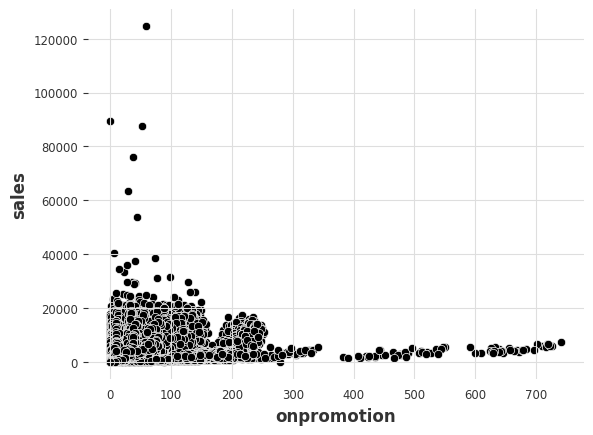

In [121]:
sns.scatterplot(x="onpromotion",
                y="sales",
                data=train_set,
                color="black"
               )
plt.show()

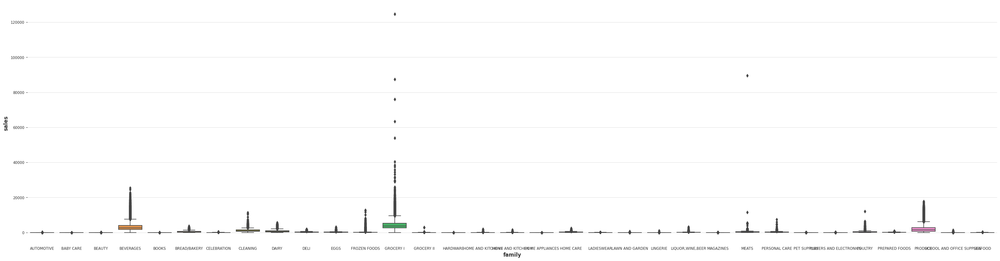

In [122]:
plt.figure(figsize=(40,10))
sns.boxplot(x="family",y="sales",data=train_set)
plt.show()

In [123]:
group_family=train_set.groupby(by="family",as_index=False)["sales"].agg(
    {"family_count":"count",
     "family_mean":"mean",
     "family_sum":"sum"}
).sort_values(by=["family_mean","family_sum"],ascending=[False,False])
apply_styling_to_dataframe(group_family)

,family,family_count,family_mean,family_sum
12,GROCERY I,39428,4445.010248,175257864.056000
3,BEVERAGES,39428,3289.791747,129709909.000000
30,PRODUCE,39428,2292.090206,90372532.648220
7,CLEANING,39428,1188.034569,46841827.000000
8,DAIRY,39428,870.901060,34337887.000000
5,BREAD/BAKERY,39428,528.143294,20823633.808035
28,POULTRY,39428,389.466549,15355887.090947
24,MEATS,39428,357.905751,14111507.956995
25,PERSONAL CARE,39428,316.481358,12478227.000000
9,DELI,39428,300.387998,11843698.000978


In [124]:
spearman_corr,_=spearmanr(train_set["sales"],train_set["onpromotion"])
print(f"the correlation between sales and onpromotion is: {np.round(spearman_corr,3)}")

the correlation between sales and onpromotion is: 0.681


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
transactions feature is highly correlated with sales but first, you are supposed to sum the sales feature to find relationship. Transactions means how many people came to the store or how many invoices created in a day.

Sales gives the total sales for a product family at a particular store at a given date. Fractional values are possible since products can be sold in fractional units (1.5 kg of cheese, for instance, as opposed to 1 bag of chips).

That's why, transactions will be one of the relevant features in the model. In the following sections, we will generate new features by using transactions.

# transactions

In [125]:
apply_styling_to_dataframe(transactions.sort_values(["store_nbr", "date"]).head())

,date,store_nbr,transactions
1,2013-01-02 00:00:00,1,2111
47,2013-01-03 00:00:00,1,1833
93,2013-01-04 00:00:00,1,1863
139,2013-01-05 00:00:00,1,1509
185,2013-01-06 00:00:00,1,520


In [126]:
temp = pd.merge(train.groupby(["date","store_nbr"]).sales.sum().reset_index(), 
                transactions,
                how = "left"
               )

print("the Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr().sales.loc["transactions"]))

px.line(transactions.sort_values(["store_nbr", "date"]), 
        x='date', 
        y='transactions', 
        color='store_nbr',
        title="Transactions" 
       )

the Correlation between Total Sales and Transactions: 0.9169


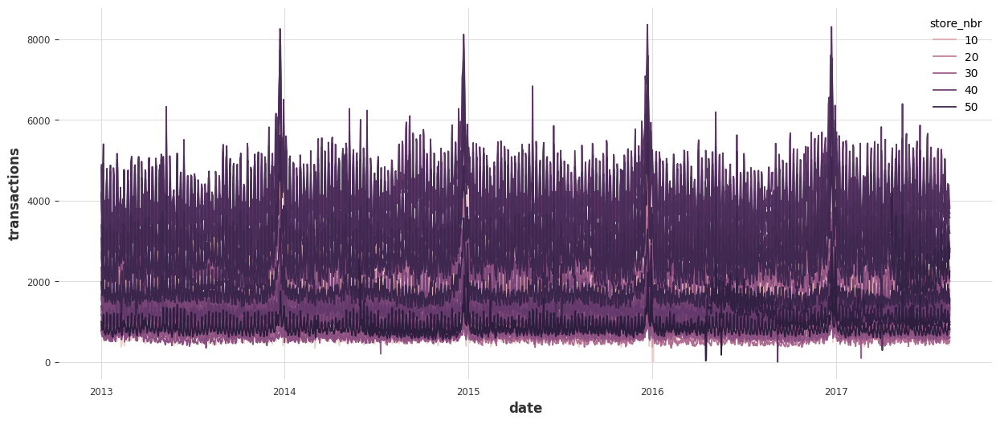

In [127]:
# the same plot using seaborn 
plt.figure(figsize=(15,6))
sns.lineplot(data=transactions.sort_values(["store_nbr", "date"]),
             x="date",
             y="transactions",
             hue="store_nbr",
            )
plt.show()

In [128]:
# Purchases increase every first year
store_3=transactions.sort_values(["store_nbr", "date"])
store_3=store_3[store_3.store_nbr==3]
px.line(data_frame=store_3, 
        x='date', 
        y='transactions', 
        color='store_nbr',
        title="Transactions"
       )


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
There is a stable pattern in Transaction. All months are similar except December from 2013 to 2017 by boxplot. In addition, we've just seen same pattern for each store in previous plot. Store sales had always increased at the end of the year.

In [129]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month_name()
px.box(a, 
       x="year",
       y="transactions" , 
       color = "month",
       title = "Transactions"
      )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
Let's take a look at transactions by using monthly average sales!
We've just learned a pattern what increases sales. It was the end of the year. We can see that transactions increase in spring and decrease after spring.

In [130]:
a = transactions.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(data_frame=a, 
        x='date',
        y='transactions',
        color='year',
        title = "Monthly Average Transactions"
       )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
When we look at their relationship, we can see that there is a highly correlation between total sales and transactions also. 

In [131]:
px.scatter(temp, 
           x = "transactions",
           y = "sales",
           trendline = "ols", 
           trendline_color_override = "red"
          )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
    
The days of week is very important for shopping. It shows us a great pattern. Stores make more transactions at weekends. Almost, the patterns are same from 2013 to 2017 and Saturday is the most important day for shopping.

In [132]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, 
        x="dayofweek",
        y="transactions" ,
        color = "year",
        title = "Transactions"
       )

# sales

In [133]:
a=train_set.groupby(["store_nbr","date"],as_index=False).sales.mean()
px.line(data_frame=a,
        x="date",
        y="sales",
        color="store_nbr",
        title="Daily total sales of the stors"
       )

In [134]:
pivot_stores=a.pivot_table(values='sales', index="date", columns='store_nbr', aggfunc='first')
pivot_stores.head()

store_nbr,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-08-15,374.96,546.86,1525.90,459.35,357.51,625.82,697.95,948.81,619.19,232.41,534.43,518.87,411.34,275.78,227.45,211.27,631.65,327.57,389.20,417.91,540.72,0.00,249.69,628.82,288.90,161.99,470.49,493.35,348.54,165.86,443.31,131.79,358.71,402.67,196.44,319.84,471.76,462.26,457.02,505.11,356.57,0.00,393.99,1937.16,1509.86,1131.56,1273.94,927.73,1325.38,758.01,783.32,0.00,299.59,245.30
2015-08-16,118.97,536.48,1371.42,459.33,376.41,653.17,508.08,778.96,682.29,202.24,588.16,240.47,224.02,161.69,179.27,257.65,438.72,351.38,284.24,497.46,736.98,0.00,227.22,537.64,223.38,193.47,625.51,682.45,496.05,188.90,526.88,156.17,383.05,372.79,198.32,402.67,368.84,457.25,406.55,495.61,477.38,0.00,471.01,1695.53,1427.69,1129.10,1414.75,1047.59,1123.59,697.35,897.25,0.00,372.19,348.77
2015-08-17,317.16,388.00,980.36,367.65,286.39,446.99,533.89,562.95,536.13,183.80,526.39,229.93,288.54,228.78,258.03,185.88,359.39,465.42,257.96,322.45,387.68,0.00,219.05,504.42,171.66,135.11,391.89,363.25,306.19,138.91,354.64,124.65,305.97,359.77,216.58,262.77,490.36,402.54,370.55,419.90,270.61,0.00,337.86,1110.48,1035.81,713.81,942.11,561.76,816.92,555.97,637.80,0.00,198.82,219.02
2015-08-18,300.13,325.56,913.84,302.36,287.75,379.02,501.54,502.95,485.60,174.82,505.95,189.31,256.38,205.96,243.35,198.56,340.07,301.29,233.33,293.66,360.23,0.00,190.63,494.08,161.39,113.87,329.35,357.50,323.49,170.84,355.30,100.94,309.35,324.22,159.60,405.70,413.85,327.92,412.12,430.30,282.61,0.00,333.17,981.76,821.29,603.04,775.08,462.91,745.50,450.67,551.69,0.00,187.44,197.73
2015-08-19,348.63,418.99,1049.47,342.36,309.47,441.56,532.62,658.56,423.44,148.78,481.51,189.01,162.20,159.60,228.54,172.66,295.20,211.74,224.61,253.03,310.93,0.00,203.27,577.00,232.52,120.10,408.74,274.74,225.91,126.60,260.24,75.43,227.09,257.00,114.07,315.95,461.01,478.61,353.27,355.92,305.64,0.00,315.35,1247.71,941.67,651.07,870.16,502.54,849.99,459.21,823.87,0.00,259.06,153.44


In [135]:
# bcr.bar_chart_race(df=pivot_stores)

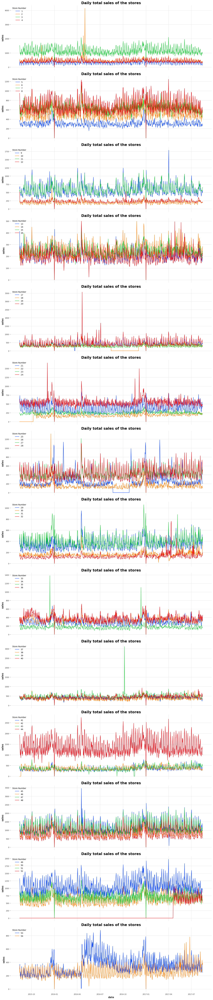

In [136]:
number_of_stores = train.store_nbr.nunique()
stores = sorted(train.store_nbr.unique())
number_of_rows = ceil(number_of_stores / 4)
c = 0
palette=sns.color_palette("bright")
a=train_set.groupby(["date", "store_nbr"], as_index=False).sales.mean()
fig, axes = plt.subplots(nrows=number_of_rows, 
                         ncols=1, 
                         sharex=True,
                         figsize=(15, 5*number_of_rows)
                        )

for i, ax in enumerate(axes.flatten()):
    try:
        arr = stores[c:c+4]
    except:
        arr = stores[c:]
    c += 4
    df = a.query("store_nbr in @arr")
    sns.lineplot(data=df,
                 x="date",
                 y="sales", 
                 hue="store_nbr", 
                 ax=ax,
                 palette=palette
                )
    ax.set_title("Daily total sales of the stores")
    ax.legend(title='Store Number',
              loc='upper left'
             )

plt.tight_layout()
plt.show()


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

I realized some unnecessary rows in the data while I was looking at the time serie of the stores one by one. If you select the stores from above, some of them have no sales at the beginning of 2013. You can see them, if you look at the those stores 20, 21, 22, 29, 36, 42, 52 and 53. I decided to remove those rows before the stores opened. i will remove them above

In [137]:
b=a.query('store_nbr in [52,22,42,21,29,20,53,36]')
px.line(data_frame=b,
        x="date",
        y="sales",
        color="store_nbr",
        title="Daily total sales of the stors"
       )

In [138]:
print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]
train.shape

(1300860, 9)


(1278651, 9)

In [139]:
print(train_set.shape)
train_set = train_set[~((train_set.store_nbr == 52) & (train_set.date < "2017-04-20"))]
train_set = train_set[~((train_set.store_nbr == 22) & (train_set.date < "2015-10-09"))]
train_set = train_set[~((train_set.store_nbr == 42) & (train_set.date < "2015-08-21"))]
train_set = train_set[~((train_set.store_nbr == 21) & (train_set.date < "2015-07-24"))]
train_set = train_set[~((train_set.store_nbr == 29) & (train_set.date < "2015-03-20"))]
train_set = train_set[~((train_set.store_nbr == 20) & (train_set.date < "2015-02-13"))]
train_set = train_set[~((train_set.store_nbr == 53) & (train_set.date < "2014-05-29"))]
train_set = train_set[~((train_set.store_nbr == 36) & (train_set.date < "2013-05-09"))]
train_set.shape

(1301124, 14)


(1278915, 14)

# family

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

Some stores don't sell some product families. In the following code, you can see which products aren't sold in which stores. It isn't difficult to forecast them next 15 days. Their forecasts must be 0 next 15 days.

I will remove them from the data and create a new data frame for product families which never sell. Then, when we are at submission part, I will combine that data frame with our predictions.

In [140]:
c = train_set.groupby(["store_nbr", "family"]).sales.sum().reset_index().sort_values(["family","store_nbr"])
c = c[c.sales == 0]
apply_styling_to_dataframe(c)

,store_nbr,family,sales
1,1,BABY CARE,0.000000
397,13,BABY CARE,0.000000
727,23,BABY CARE,0.000000
1420,44,BABY CARE,0.000000
1453,45,BABY CARE,0.000000
1486,46,BABY CARE,0.000000
1519,47,BABY CARE,0.000000
1552,48,BABY CARE,0.000000
1585,49,BABY CARE,0.000000
1618,50,BABY CARE,0.000000


In [141]:
print(train_set.shape)
# Anti Join
outer_join = train_set.merge(c[c.sales == 0].drop("sales",axis = 1), how = 'outer', indicator = True)
train_set= outer_join[~(outer_join._merge == 'both')].drop('_merge', axis = 1)
del outer_join
gc.collect()
train_set.shape

(1278915, 14)


(1238574, 14)

In [142]:
outer_join=test_set.merge(c.drop("sales",axis=1),how="outer",indicator=True)

def update_value(merge_value):
    if merge_value == 'both':
        return 0
    else:
        return 'unknown'

outer_join['_merge'] = outer_join['_merge'].apply(update_value)

outer_join.rename(columns={"_merge":"sales"},inplace=True)
test_set=outer_join

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

## Are The Product Families Active or Passive?

Some products can sell rarely in the stores.some products are passive if they never bought in the last two months. I want to apply this domain knowledge here and I will look on the last 60 days.

However, some product families depends on seasonality. Some of them might not active on the last 60 days but it doesn't mean it is passive.

In [143]:
c = train.groupby(["store_nbr", "family"]).tail(60).groupby(["store_nbr", "family"]).sales.sum().reset_index()
apply_styling_to_dataframe(c[c.sales == 0])

,store_nbr,family,sales
1,1,BABY CARE,0.000000
31,1,SCHOOL AND OFFICE SUPPLIES,0.000000
34,2,BABY CARE,0.000000
37,2,BOOKS,0.000000
64,2,SCHOOL AND OFFICE SUPPLIES,0.000000
70,3,BOOKS,0.000000
136,5,BOOKS,0.000000
169,6,BOOKS,0.000000
196,6,SCHOOL AND OFFICE SUPPLIES,0.000000
268,9,BOOKS,0.000000


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
As you can see below, these examples are too rare and also the sales are low. I'm open your suggestions for these families. I won't do anything for now but, you would like to improve your model you can focus on that.

But still, I want to use that knowledge whether it is simple and I will create a new feature. It shows that the product family is active or not.

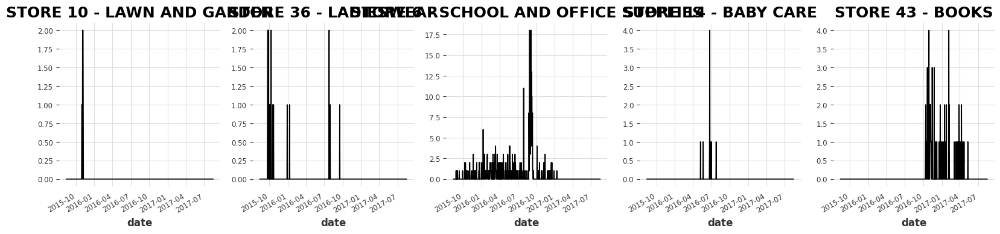

In [144]:
fig, ax = plt.subplots(1,5, figsize = (20,4))
train[(train.store_nbr == 10) & (train.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
train[(train.store_nbr == 36) & (train.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
train[(train.store_nbr == 6) & (train.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
train[(train.store_nbr == 14) & (train.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 14 - BABY CARE")
train[(train.store_nbr == 53) & (train.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 43 - BOOKS",fontsize="small")
plt.show()

In [145]:
c=train_set.groupby(["store_nbr","family","date"],as_index=False).agg({"sales":"sum","transactions":"mean"})
apply_styling_to_dataframe(c.head())

,store_nbr,family,date,sales,transactions
0,1,AUTOMOTIVE,2015-08-15 00:00:00,3.000000,1379.000000
1,1,AUTOMOTIVE,2015-08-16 00:00:00,1.000000,456.000000
2,1,AUTOMOTIVE,2015-08-17 00:00:00,0.000000,1683.000000
3,1,AUTOMOTIVE,2015-08-18 00:00:00,10.000000,1811.000000
4,1,AUTOMOTIVE,2015-08-19 00:00:00,4.000000,1844.000000


In [146]:
a = train.set_index("date").groupby("family").resample("D").sales.mean().reset_index()
px.line(a,
        x = "date",
        y= "sales",
        color = "family", 
        title = "Daily total sales of the family"
       )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

In this case I think it is better to build a model for each product

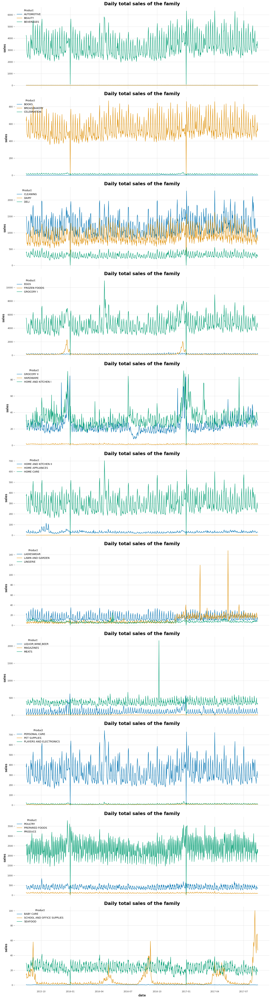

In [147]:
number_of_families = train_set.family.nunique()
families = train_set.family.unique()
number_of_rows = ceil(number_of_families / 3)
c = 0
palette=sns.color_palette("colorblind")
a=train_set.set_index("date").groupby("family").resample("D").sales.mean().reset_index()

fig, axes = plt.subplots(nrows=number_of_rows, 
                         ncols=1, 
                         sharex=True,
                         figsize=(15, 5*number_of_rows)
                        )

for i, ax in enumerate(axes.flatten()):
    try:
        arr = families[c:c+3]
    except:
        arr = families[c:]
    c += 3
    df = a.reset_index().query("family in @arr")
    sns.lineplot(data=df,
                 x="date",
                 y="sales", 
                 hue="family", 
                 ax=ax,
                 palette=palette,
                )
    ax.set_title("Daily total sales of the family")
    ax.legend(title="Product",
              loc='upper left'
             )

plt.tight_layout()
plt.show()

In [148]:
total_sales_df = a.pivot(index='date',columns='family', values='sales')
total_sales_df.head()

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-08-15,8.90,0.45,4.92,4257.55,0.00,637.45,22.69,1487.00,952.51,391.12,220.24,197.55,5499.83,30.43,2.12,37.24,29.92,0.90,371.06,21.44,6.09,10.29,184.76,3.00,400.08,380.35,7.25,24.51,484.68,134.40,2512.69,13.75,29.55
2015-08-16,8.10,0.28,6.14,4082.61,0.00,683.37,14.20,1486.75,998.63,415.26,234.84,147.57,5228.57,28.25,1.22,27.80,36.27,0.88,387.39,23.29,5.00,10.39,0.00,3.08,404.24,412.71,7.04,17.90,499.62,130.20,2578.31,15.55,28.41
2015-08-17,5.67,0.35,3.43,2936.10,0.00,516.90,11.63,1170.94,752.12,308.92,210.06,100.89,4022.56,22.76,0.96,22.41,26.33,0.71,276.86,13.76,3.50,9.41,58.20,2.45,327.94,291.25,5.16,11.63,363.71,102.21,2015.09,8.98,22.87
2015-08-18,5.78,0.25,3.25,2600.18,0.00,468.94,13.90,1034.29,652.41,276.85,159.27,99.04,3549.33,18.73,1.35,23.16,25.88,0.61,239.25,11.83,4.25,7.37,58.51,2.00,301.51,256.16,3.78,10.18,308.28,93.30,2087.61,9.69,18.66
2015-08-19,6.16,0.12,3.45,2575.84,0.00,470.49,11.75,1003.08,701.18,259.80,156.88,105.34,3500.99,19.82,1.08,22.20,24.49,0.53,236.12,12.00,6.00,7.27,74.24,2.00,306.95,246.69,5.04,10.49,320.80,103.43,2597.05,10.69,19.54


In [149]:
px.line(a[a.family=="HARDWARE"],
        x = "date",
        y= "sales",
        color = "family", 
        title = "Daily total sales of the family"
       )

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">
We are working with the stores. Well, there are plenty of products in the stores and we need to know which product family sells much more? Let's make a barplot to see that.

The graph shows us GROCERY I and BEVERAGES are the top selling families.

In [150]:
a = train.groupby("family").sales.mean().sort_values(ascending = False).reset_index()
px.bar(a,
       y = "family",
       x="sales",
       color = "family",
       title = "Which product family preferred more?"
      )

In [151]:
train_set.drop(["transactions"],axis=1,inplace=True)
test_set.drop(["transactions"],axis=1,inplace=True)

In [152]:
apply_styling_to_dataframe(train_set.head())

,date,store_nbr,family,sales,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,dcoilwtico
0,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,Saturday,August,6,Quito,Pichincha,D,13,47.570000
1,2015-08-16 00:00:00,1,AUTOMOTIVE,1.000000,0,Sunday,August,7,Quito,Pichincha,D,13,47.570000
2,2015-08-17 00:00:00,1,AUTOMOTIVE,0.000000,0,Monday,August,1,Quito,Pichincha,D,13,41.930000
3,2015-08-18 00:00:00,1,AUTOMOTIVE,10.000000,0,Tuesday,August,2,Quito,Pichincha,D,13,42.580000
4,2015-08-19 00:00:00,1,AUTOMOTIVE,4.000000,0,Wednesday,August,3,Quito,Pichincha,D,13,40.750000


In [153]:
apply_styling_to_dataframe(test_set.head())

,date,store_nbr,family,onpromotion,day_name,month_name,dayofweek,city,state,type,cluster,dcoilwtico,sales
0,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,3,Quito,Pichincha,D,13,46.800000,unknown
1,2017-08-17 00:00:00,1,AUTOMOTIVE,0,Thursday,August,4,Quito,Pichincha,D,13,47.070000,unknown
2,2017-08-18 00:00:00,1,AUTOMOTIVE,0,Friday,August,5,Quito,Pichincha,D,13,48.590000,unknown
3,2017-08-19 00:00:00,1,AUTOMOTIVE,0,Saturday,August,6,Quito,Pichincha,D,13,48.590000,unknown
4,2017-08-20 00:00:00,1,AUTOMOTIVE,0,Sunday,August,7,Quito,Pichincha,D,13,48.590000,unknown


In [154]:
missing_train=train_set.isna().sum().sum()
missing_test=test_set.isna().sum().sum()
print(f"the number of missing values in train data is: {missing_train}")
print(f"the number of missing values in test data is: {missing_test}")

the number of missing values in train data is: 0
the number of missing values in test data is: 0


In [155]:
def check_same_features(train,test):
    features_train=train.columns.tolist()
    features_test=train.columns.tolist()
    len_feat_train=len(features_train)
    len_feat_test=len(features_test)
    if len_feat_train != len_feat_test :
        return False
    for feature in features_train:
        if feature not in features_test:
            print(feature)
            return False
    return True

print(check_same_features(train_set,test_set))

True


In [156]:
train_set.drop_duplicates(inplace=True)
test_set.drop_duplicates(inplace=True)

In [157]:
week_sales=train_set.groupby(["day_name","date"],as_index=False).agg(mean_sales=("sales","mean"))
apply_styling_to_dataframe(week_sales.head())

,day_name,date,mean_sales
0,Friday,2015-08-21 00:00:00,393.069319
1,Friday,2015-08-28 00:00:00,382.513377
2,Friday,2015-09-04 00:00:00,443.077799
3,Friday,2015-09-11 00:00:00,391.895408
4,Friday,2015-09-18 00:00:00,393.385003


In [158]:
px.line(data_frame=week_sales,
        x="date",
        y="mean_sales",
        color="day_name",
        title="mean of sales for each week"
       )

In [159]:
month_sales=train_set.groupby(["month_name","date"],as_index=False).agg(mean_sales=("sales","mean"))
apply_styling_to_dataframe(month_sales.head())

,month_name,date,mean_sales
0,April,2016-04-01 00:00:00,515.033837
1,April,2016-04-02 00:00:00,679.353354
2,April,2016-04-03 00:00:00,747.879747
3,April,2016-04-04 00:00:00,469.443443
4,April,2016-04-05 00:00:00,428.423909


In [160]:
px.line(data_frame=month_sales,
        x="date",
        y="mean_sales",
        color="month_name",
        title="mean of sales for each month"
       )

# <a id="libraries"></a>
# <b><span style='color:#c78a44'> Feature Extraction</span></b>

In [161]:
def create_features(df):
    df["dayofweek"]=df["date"].dt.dayofweek
    df["month"]=df["date"].dt.month
    
    return df
train_set=create_features(train_set)
test_set=create_features(test_set)

In [162]:
train_set.drop(["dayofweek"],axis=1,inplace=True)
test_set.drop(["dayofweek"],axis=1,inplace=True)

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

as we have seen before the are some cities that have the same distribution of sales using the date feature so i prefer to group the cities that have the same distribution of sales to be one category 

In [163]:
def extraction_feature_city(cities):
    new_cities=[]
    for city in cities:
        if city in ["Ibarra","Latacunga","Riobamba"]:
            value="ibarra_latacunga_riobamba"
        elif city in ["Cayambe","Quito"]:
            value="cayambe_quito"
        elif city in ["Cuenca","Libertad","Loja","Esmeraldas","Machala"]:
            value="cuenca_libertad_loja_esmeraldas_machala"
#         elif city in ["Esmeraldas","Machala"]:
#             value="esmeraldas_machala"
        elif city in ["El Carmen","Guaranda"]:
            value="el_carmen_guaranda"
        else:
            value=city
        new_cities.append(value)
    return new_cities
cit=extraction_feature_city(train_set.city)


In [164]:
print(train_set.city.value_counts())

city
Quito            424860
Guayaquil        185420
Cuenca            71342
Santo Domingo     70080
Ambato            46720
Machala           46720
Latacunga         44530
Manta             27748
Daule             24090
Loja              24090
Libertad          23360
Babahoyo          23360
Cayambe           23360
Guaranda          23360
Salinas           23360
Riobamba          22630
Ibarra            22630
Playas            22630
Esmeraldas        22630
Quevedo           21900
El Carmen         21900
Puyo              21600
Name: count, dtype: int64


In [165]:
train_set.city=cit

In [166]:
print(train_set.city.value_counts())

city
cayambe_quito                              448220
cuenca_libertad_loja_esmeraldas_machala    188142
Guayaquil                                  185420
ibarra_latacunga_riobamba                   89790
Santo Domingo                               70080
Ambato                                      46720
el_carmen_guaranda                          45260
Manta                                       27748
Daule                                       24090
Babahoyo                                    23360
Salinas                                     23360
Playas                                      22630
Quevedo                                     21900
Puyo                                        21600
Name: count, dtype: int64


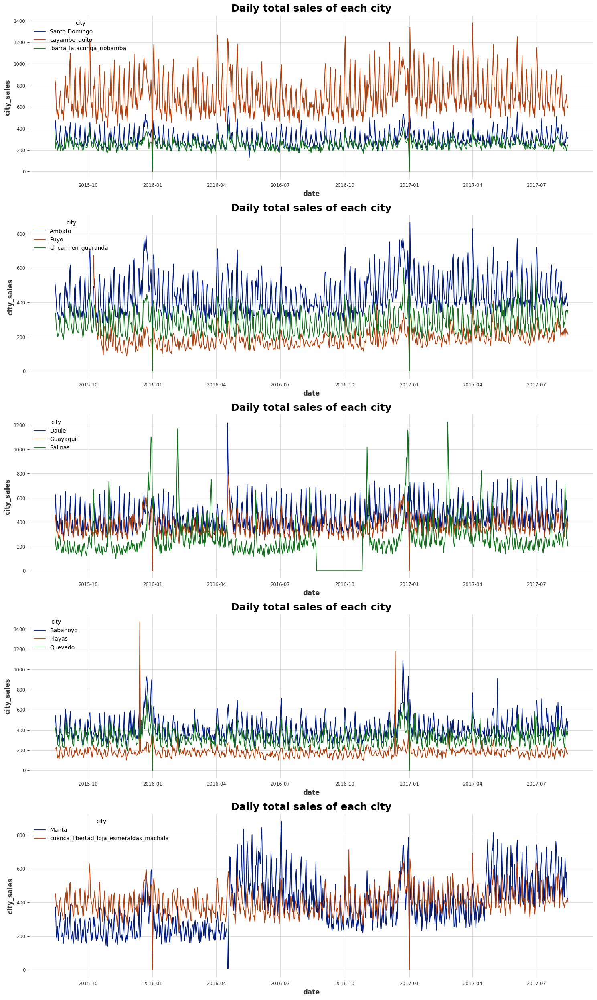

In [167]:
number_of_cities = train_set.city.nunique()
cities = train_set.city.unique()
number_of_rows = ceil(number_of_cities/ 3)
c = 0
palette=sns.color_palette("dark")
a=train_set.groupby(["city","date"],as_index=False).agg(city_sales=("sales","mean"))
fig, axes = plt.subplots(nrows=number_of_rows, 
                         ncols=1, 
                         sharex=False,
                         figsize=(15, 5*number_of_rows)
                        )

for i, ax in enumerate(axes.flatten()):
    try:
        arr = cities[c:c+3]
    except:
        arr = cities[c:]
    c += 3
    df=a.query("city in @arr")
    sns.lineplot(data=df,
                 x="date",
                 y="city_sales", 
                 hue="city", 
                 ax=ax,
                 palette=palette
                )
    ax.set_title("Daily total sales of each city")
    ax.legend(title='city',
              loc='upper left'
             )

plt.tight_layout()
plt.show()


In [168]:
test_set.city=extraction_feature_city(test_set.city)
apply_styling_to_dataframe(test_set.head())

,date,store_nbr,family,onpromotion,day_name,month_name,city,state,type,cluster,dcoilwtico,sales,month
0,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,cayambe_quito,Pichincha,D,13,46.800000,unknown,8
1,2017-08-17 00:00:00,1,AUTOMOTIVE,0,Thursday,August,cayambe_quito,Pichincha,D,13,47.070000,unknown,8
2,2017-08-18 00:00:00,1,AUTOMOTIVE,0,Friday,August,cayambe_quito,Pichincha,D,13,48.590000,unknown,8
3,2017-08-19 00:00:00,1,AUTOMOTIVE,0,Saturday,August,cayambe_quito,Pichincha,D,13,48.590000,unknown,8
4,2017-08-20 00:00:00,1,AUTOMOTIVE,0,Sunday,August,cayambe_quito,Pichincha,D,13,48.590000,unknown,8


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

as we have seen before the are some states that have the same distribution of sales using the date feature so i prefer to group the states that have the same distribution of sales to be one category 

In [169]:
def extraction_feature_state(states):
    new_states=[]
    for state in states:
        if state in ["Pichincha","Guayas","Tungurahua","Bolivar"]:
            value="pichincha_guayas_tungurahua_bolivar"
        elif state in ["Cotopaxi","Santo Domingo de los Tsachilas"]:
            value="cotopaxi_santo_domingo_de_los_tsachilas"
        elif state in ["El Oro","Esmeraldas"]:
            value="el_oro_esmeraldas"
        else:
            value=state
        new_states.append(value)
    return new_states
stat_train=extraction_feature_state(train_set.state.values)

In [170]:
train_set.state=stat_train
stat_test=extraction_feature_state(test_set.state.values)
test_set.state=stat_test

In [171]:
result=check_same_features(train_set,test_set)
print(f"are the features in train set and test set the same: {check_same_features(train_set,test_set)}")

are the features in train set and test set the same: True


In [172]:
train_set['week_number'] = train_set['date'].dt.isocalendar().week
test_set['week_number'] = test_set['date'].dt.isocalendar().week
train_set["year"] = train_set.date.dt.year
test_set["year"] = test_set.date.dt.year

In [173]:
apply_styling_to_dataframe(train_set.head())

,date,store_nbr,family,sales,onpromotion,day_name,month_name,city,state,type,cluster,dcoilwtico,month,week_number,year
0,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,Saturday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,47.570000,8,33,2015
1,2015-08-16 00:00:00,1,AUTOMOTIVE,1.000000,0,Sunday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,47.570000,8,33,2015
2,2015-08-17 00:00:00,1,AUTOMOTIVE,0.000000,0,Monday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,41.930000,8,34,2015
3,2015-08-18 00:00:00,1,AUTOMOTIVE,10.000000,0,Tuesday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,42.580000,8,34,2015
4,2015-08-19 00:00:00,1,AUTOMOTIVE,4.000000,0,Wednesday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,40.750000,8,34,2015


In [174]:
apply_styling_to_dataframe(test_set.head())

,date,store_nbr,family,onpromotion,day_name,month_name,city,state,type,cluster,dcoilwtico,sales,month,week_number,year
0,2017-08-16 00:00:00,1,AUTOMOTIVE,0,Wednesday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,46.800000,unknown,8,33,2017
1,2017-08-17 00:00:00,1,AUTOMOTIVE,0,Thursday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,47.070000,unknown,8,33,2017
2,2017-08-18 00:00:00,1,AUTOMOTIVE,0,Friday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,48.590000,unknown,8,33,2017
3,2017-08-19 00:00:00,1,AUTOMOTIVE,0,Saturday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,48.590000,unknown,8,33,2017
4,2017-08-20 00:00:00,1,AUTOMOTIVE,0,Sunday,August,cayambe_quito,pichincha_guayas_tungurahua_bolivar,D,13,48.590000,unknown,8,33,2017


In [175]:
train_set.week_number.unique()

<IntegerArray>
[33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
 52, 53,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]
Length: 53, dtype: UInt32

In [176]:
weeks_average_sales=train_set.groupby(["week_number","family"],as_index=False).agg(avg_sales_each_week=("sales","mean"))
px.line(data_frame=weeks_average_sales,
        x="week_number",
        y="avg_sales_each_week",
        color="family",
        title="the average of sales for each week"
       )

In [177]:
train_set['day of month'] = train_set['date'].dt.day
test_set['day of month'] = test_set['date'].dt.day
train_set['date_offset'] = (train_set['date'].dt.month*100+train_set["date"].dt.day-320)%1300
test_set['date_offset'] = (test_set['date'].dt.month*100+test_set["date"].dt.day-320)%1300
train_set["season"]=pd.cut(train_set["date_offset"],
                           [0,300,602,900,1300],
                           labels=["spring","summer","fall","winter"]
                          )

test_set["season"]=pd.cut(test_set["date_offset"],
                          [0,300,602,900,1300],
                          labels=["spring","summer","fall","winter"]
                         )

In [178]:
train_set.drop(["date_offset"],axis=1,inplace=True)
test_set.drop(["date_offset"],axis=1,inplace=True)

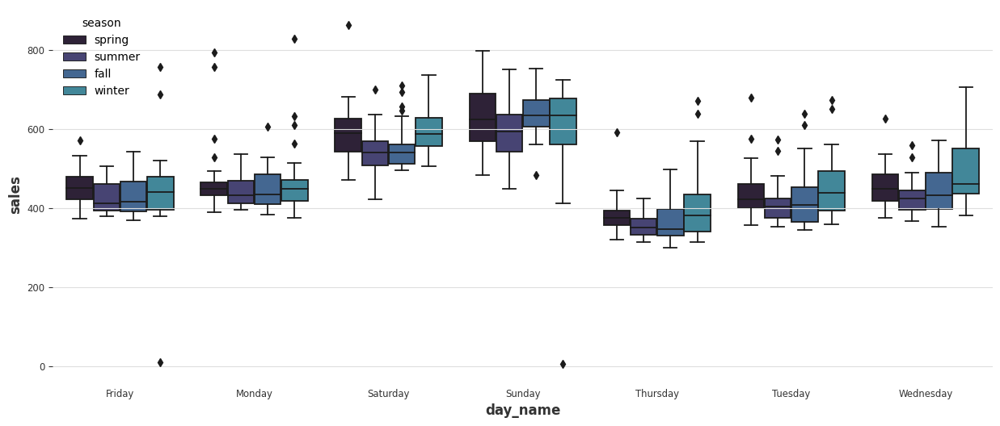

In [179]:
palette=sns.color_palette("mako")
plt.figure(figsize=(15,6))
a=train_set.groupby(["season","day_name","date"],
                    as_index=False
                   ).sales.mean()

sns.boxplot(data=a,
            x="day_name",
            y="sales",
            hue="season",
            palette=palette
           )

plt.show()

In [180]:
a=train_set.groupby(
    ["season","date"],
    as_index=False
).sales.mean()

px.line(data_frame=a,
        x="date",
        y="sales",
        color="season"
       )

<a id="libraries"></a>
# <b><span style='color:#c78a44'> Feature Processing</span></b>

In [181]:
test_set["id"]=test.id

train_set.drop(["day_name","month_name"],axis=1,inplace=True)
test_set.drop(["day_name","month_name"],axis=1,inplace=True)

In [182]:
train_set["dayofyear"]=train_set["date"].dt.dayofyear
test_set["dayofyear"]=test_set["date"].dt.dayofyear

In [183]:
categorical_features=train_set.select_dtypes(include=["object","category"]).columns.tolist()
date_feature=train_set[["date"]].columns.tolist()
numerical_feateures=test_set.select_dtypes(include=["int32", "int64","float64","UInt32"]).columns.tolist()
y_train=train_set.sales
y_test=test_set.sales
print(f"all categorical features are: {categorical_features}")
print(f"all numberical features are: {numerical_feateures}")
train_set.dtypes

all categorical features are: ['family', 'city', 'state', 'type', 'season']
all numberical features are: ['store_nbr', 'onpromotion', 'cluster', 'dcoilwtico', 'month', 'week_number', 'year', 'day of month', 'id', 'dayofyear']


date            datetime64[ns]
store_nbr                int64
family                  object
sales                  float64
onpromotion              int64
city                    object
state                   object
type                    object
cluster                  int64
dcoilwtico             float64
month                    int32
week_number             UInt32
year                     int32
day of month             int32
season                category
dayofyear                int32
dtype: object

In [184]:
train_set.groupby(["store_nbr","family"],as_index=False).agg(
    count_unique_city=("city","nunique"),
    count_unique_state=("state","nunique"),
    count_unique_type=("type","nunique")
).sort_values(by=["count_unique_city","count_unique_state","count_unique_type"],ascending=[False,False,False],).head()

,store_nbr,family,count_unique_city,count_unique_state,count_unique_type
0,1,AUTOMOTIVE,1,1,1
1,1,BEAUTY,1,1,1
2,1,BEVERAGES,1,1,1
3,1,BOOKS,1,1,1
4,1,BREAD/BAKERY,1,1,1


In [185]:
def drop_features(data,features):
    data.drop(features,axis=1,inplace=True)
    return data
train_set=drop_features(train_set,["city","state","type"])
test_set=drop_features(test_set,["city","state","type"])
apply_styling_to_dataframe(train_set.head(3))

,date,store_nbr,family,sales,onpromotion,cluster,dcoilwtico,month,week_number,year,day of month,season,dayofyear
0,2015-08-15 00:00:00,1,AUTOMOTIVE,3.000000,0,13,47.570000,8,33,2015,15,summer,227
1,2015-08-16 00:00:00,1,AUTOMOTIVE,1.000000,0,13,47.570000,8,33,2015,16,summer,228
2,2015-08-17 00:00:00,1,AUTOMOTIVE,0.000000,0,13,41.930000,8,34,2015,17,summer,229


In [186]:
apply_styling_to_dataframe(test_set.head(2))

,date,store_nbr,family,onpromotion,cluster,dcoilwtico,sales,month,week_number,year,day of month,season,id,dayofyear
0,2017-08-16 00:00:00,1,AUTOMOTIVE,0,13,46.800000,unknown,8,33,2017,16,summer,3000888,228
1,2017-08-17 00:00:00,1,AUTOMOTIVE,0,13,47.070000,unknown,8,33,2017,17,summer,3000889,229


<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

i want to analyze the sales and visualize it for just a store and a product to decide should i create a mode for each family for a store or not

In [187]:
bread_bakery_store_44=train_set[(train_set.store_nbr==44)&(train_set.family=="BREAD/BAKERY")]
bread_bakery_store_44.drop(["store_nbr","family"],axis=1,inplace=True)
apply_styling_to_dataframe(bread_bakery_store_44.head(3))

,date,sales,onpromotion,cluster,dcoilwtico,month,week_number,year,day of month,season,dayofyear
1037738,2015-08-15 00:00:00,1875.308000,3,5,47.570000,8,33,2015,15,summer,227
1037739,2015-08-16 00:00:00,1708.187000,3,5,47.570000,8,33,2015,16,summer,228
1037740,2015-08-17 00:00:00,1161.661000,1,5,41.930000,8,34,2015,17,summer,229


In [188]:
print(f"the mean of sales for 44 store and break product: {round(bread_bakery_store_44.sales.mean(),2)}")
print(f"the standard deviation of sales for 44 store and break product: {round(bread_bakery_store_44.sales.std(),2)}")

the mean of sales for 44 store and break product: 1612.53
the standard deviation of sales for 44 store and break product: 483.55


In [189]:
px.line(data_frame=bread_bakery_store_44,x="date",y="sales")

In [190]:
def creating_new_features(data):
    
    data["lag_1"]=data.sales.shift(1)
    data["lag_2"]=data.sales.shift(2)
    data["lag_3"]=data.sales.shift(3)
    data["lag_4"]=data.sales.shift(4)
    data["lag_5"]=data.sales.shift(5)
    data["lag_6"]=data.sales.shift(6)
    data["lag_7"]=data.sales.shift(7)
    data["lag_8"]=data.sales.shift(8)
    data["lag_30"]=data.sales.shift(30)
    data["lag_365"]=data.sales.shift(365)
    data["lag_720"]=data.sales.shift(720)

    window_size = 7  # You can adjust this window size as needed
    data["rolling_mean_7"] = data.sales.rolling(window=window_size).mean()
    data["rolling_std_7"] = data.sales.rolling(window=window_size).std()
    window_size = 14  # You can adjust this window size as needed
    data["rolling_mean_14"] = data.sales.rolling(window=window_size).mean()
    data["rolling_std_14"] = data.sales.rolling(window=window_size).std()
    window_size = 30  # You can adjust this window size as needed
    data["rolling_mean_30"] = data.sales.rolling(window=window_size).mean()
    data["rolling_std_30"] = data.sales.rolling(window=window_size).std()
    window_size = 60  # You can adjust this window size as needed
    data["rolling_mean_60"] = data.sales.rolling(window=window_size).mean()
    data["rolling_std_60"] = data.sales.rolling(window=window_size).std()


    # Rolling with shifts [1, 7, 14]
    shifts = [1, 7, 14]
    # Calculate rolling mean with shifts
    for shift in shifts:
        data[f'rolling_shift_{shift}_mean']=data.sales.shift(shift).rolling(window=3).mean()
        data[f'rolling_shift_{shift}_std']=data.sales.shift(shift).rolling(window=3).std()
    return data
bread_bakery_store_44=creating_new_features(bread_bakery_store_44)
apply_styling_to_dataframe(bread_bakery_store_44.head(10))

,date,sales,onpromotion,cluster,dcoilwtico,month,week_number,year,day of month,season,dayofyear,lag_1,lag_2,lag_3,lag_4,lag_5,lag_6,lag_7,lag_8,lag_30,lag_365,lag_720,rolling_mean_7,rolling_std_7,rolling_mean_14,rolling_std_14,rolling_mean_30,rolling_std_30,rolling_mean_60,rolling_std_60,rolling_shift_1_mean,rolling_shift_1_std,rolling_shift_7_mean,rolling_shift_7_std,rolling_shift_14_mean,rolling_shift_14_std
1037738,2015-08-15 00:00:00,1875.308000,3,5,47.570000,8,33,2015,15,summer,227,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1037739,2015-08-16 00:00:00,1708.187000,3,5,47.570000,8,33,2015,16,summer,228,1875.308000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1037740,2015-08-17 00:00:00,1161.661000,1,5,41.930000,8,34,2015,17,summer,229,1708.187000,1875.308000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1037741,2015-08-18 00:00:00,1050.996000,2,5,42.580000,8,34,2015,18,summer,230,1161.661000,1708.187000,1875.308000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1581.718667,373.254189,nan,nan,nan,nan
1037742,2015-08-19 00:00:00,1196.038000,1,5,40.750000,8,34,2015,19,summer,231,1050.996000,1161.661000,1708.187000,1875.308000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1306.948000,351.861105,nan,nan,nan,nan
1037743,2015-08-20 00:00:00,969.526000,4,5,41.000000,8,34,2015,20,summer,232,1196.038000,1050.996000,1161.661000,1708.187000,1875.308000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1136.231667,75.791053,nan,nan,nan,nan
1037744,2015-08-21 00:00:00,1222.740000,4,5,40.450000,8,34,2015,21,summer,233,969.526000,1196.038000,1050.996000,1161.661000,1708.187000,1875.308000,nan,nan,nan,nan,nan,1312.065143,342.468463,nan,nan,nan,nan,nan,nan,1072.186667,114.733190,nan,nan,nan,nan
1037745,2015-08-22 00:00:00,1576.710900,2,5,40.450000,8,34,2015,22,summer,234,1222.740000,969.526000,1196.038000,1050.996000,1161.661000,1708.187000,1875.308000,nan,nan,nan,nan,1269.408414,271.957587,nan,nan,nan,nan,nan,nan,1129.434667,139.127048,nan,nan,nan,nan
1037746,2015-08-23 00:00:00,1533.861000,3,5,40.450000,8,34,2015,23,summer,235,1576.710900,1222.740000,969.526000,1196.038000,1050.996000,1161.661000,1708.187000,1875.308000,nan,nan,nan,1244.504700,229.794376,nan,nan,nan,nan,nan,nan,1256.325633,304.982576,nan,nan,nan,nan
1037747,2015-08-24 00:00:00,1159.859000,4,5,38.220000,8,35,2015,24,summer,236,1533.861000,1576.710900,1222.740000,969.526000,1196.038000,1050.996000,1161.661000,1708.187000,nan,nan,nan,1244.247271,229.903633,nan,nan,nan,nan,nan,nan,1444.437300,193.187210,1581.718667,373.254189,nan,nan


<a id="libraries"></a>
# <b><span style='color:#c78a44'> Label encoding</span></b>

In [191]:
categorical_features=train_set.select_dtypes(include=["object","category"]).columns.tolist()

imputer_cat=SimpleImputer(missing_values=np.nan, strategy="most_frequent")
train_set[categorical_features]=imputer_cat.fit_transform(train_set[categorical_features])

In [192]:
for cat in categorical_features:
    label_encoder=LabelEncoder()
    train_set[cat]=label_encoder.fit_transform(train_set[cat])
    test_set[cat]=label_encoder.transform(test_set[cat])
apply_styling_to_dataframe(train_set.head(2))

,date,store_nbr,family,sales,onpromotion,cluster,dcoilwtico,month,week_number,year,day of month,season,dayofyear
0,2015-08-15 00:00:00,1,0,3.000000,0,13,47.570000,8,33,2015,15,2,227
1,2015-08-16 00:00:00,1,0,1.000000,0,13,47.570000,8,33,2015,16,2,228


In [193]:
apply_styling_to_dataframe(test_set.head(2))

,date,store_nbr,family,onpromotion,cluster,dcoilwtico,sales,month,week_number,year,day of month,season,id,dayofyear
0,2017-08-16 00:00:00,1,0,0,13,46.800000,unknown,8,33,2017,16,2,3000888,228
1,2017-08-17 00:00:00,1,0,0,13,47.070000,unknown,8,33,2017,17,2,3000889,229


In [194]:
def store_product(data_set):
    data_set_new=data_set.copy()
    data_set_new["store_nbr"] = data_set_new["store_nbr"].astype(str)
    data_set_new["family"] = data_set_new["family"].astype(str)
    data_set_new["store_product"] = data_set_new["store_nbr"] + "_" + data_set_new["family"]
    data_set_new.drop(["store_nbr","family"],axis=1,inplace=True)
    return data_set_new
train_set_new=store_product(train_set)
test_set_new=store_product(test_set)
apply_styling_to_dataframe(train_set_new.head(2))

,date,sales,onpromotion,cluster,dcoilwtico,month,week_number,year,day of month,season,dayofyear,store_product
0,2015-08-15 00:00:00,3.000000,0,13,47.570000,8,33,2015,15,2,227,1_0
1,2015-08-16 00:00:00,1.000000,0,13,47.570000,8,33,2015,16,2,228,1_0


In [195]:
apply_styling_to_dataframe(test_set_new.tail(2))

,date,onpromotion,cluster,dcoilwtico,sales,month,week_number,year,day of month,season,id,dayofyear,store_product
28510,2017-08-30 00:00:00,0,3,45.960000,unknown,8,35,2017,30,2,3029398,242,54_32
28511,2017-08-31 00:00:00,0,3,47.260000,unknown,8,35,2017,31,2,3029399,243,54_32


<a id="libraries"></a>
# <b><span style='color:#c78a44'> Building Machine Learning Models</span></b>

<a id="libraries"></a>
# <b><span style='color:#c78a44'> 1. Random Forest</span></b>

![](https://av-eks-blogoptimized.s3.amazonaws.com/33019random-forest-algorithm287548.png)

In [217]:
# x_tr=train_set.drop(["sales"],axis=1)
# y_tr=train_set["sales"]
# Convert pandas dataframe to h2o frame
k=bread_bakery_store_44.drop(["date"],axis=1)
train_features=k.columns.tolist()
train_features.remove("sales")
df = h2o.H2OFrame(k)

# Define model
model = H2ORandomForestEstimator(ntrees=30, max_depth=20, nfolds=5)

# Train model 
model.train(x=train_features, y="sales", training_frame=df)
cv_summary = model.cross_validation_metrics_summary().as_data_frame()
cv_summary

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


,,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
0,mae,199.31,9.19,191.58,201.12,201.08,189.94,212.86
1,mean_residual_deviance,84909.43,8628.21,77456.96,94748.92,87643.18,74448.26,90249.82
2,mse,84909.43,8628.21,77456.96,94748.92,87643.18,74448.26,90249.82
3,r2,0.63,0.05,0.71,0.60,0.62,0.65,0.58
4,residual_deviance,84909.43,8628.21,77456.96,94748.92,87643.18,74448.26,90249.82
5,rmse,291.09,14.89,278.31,307.81,296.05,272.85,300.42
6,rmsle,0.35,0.25,0.62,0.16,0.62,0.15,0.18


In [189]:
# cv_summary["mean"].values[0]

In [190]:
# Get feature importances
feature_importance = model.varimp()

# Print feature importances
print("Feature importances:", feature_importance)

Feature importances: [('lag_7', 3666787584.0, 1.0, 0.41467942157967047), ('rolling_mean_30', 862970176.0, 0.23534774137601094, 0.0975938652638861), ('rolling_shift_7_mean', 692301952.0, 0.1888033970172841, 0.07829288346740426), ('rolling_mean_7', 665665792.0, 0.1815392292983176, 0.0752805825994455), ('rolling_mean_14', 299764544.0, 0.08175127059664442, 0.03390056960441963), ('lag_1', 258180384.0, 0.07041051004060561, 0.029197789576767916), ('rolling_shift_14_mean', 255185552.0, 0.06959376461115452, 0.0288591020545053), ('rolling_std_7', 192456112.0, 0.05248629968089256, 0.02176498839252977), ('lag_2', 192107984.0, 0.05239135881180076, 0.02172561836785051), ('lag_6', 154596944.0, 0.04216141253302553, 0.017483470162176898), ('lag_4', 131663904.0, 0.03590715332802872, 0.01488995757263949), ('lag_30', 128057840.0, 0.034923713759362394, 0.014482145421146378), ('rolling_shift_1_mean', 127879448.0, 0.034875063000104234, 0.014461970952437791), ('lag_365', 124302304.0, 0.03389951044407158, 0.01

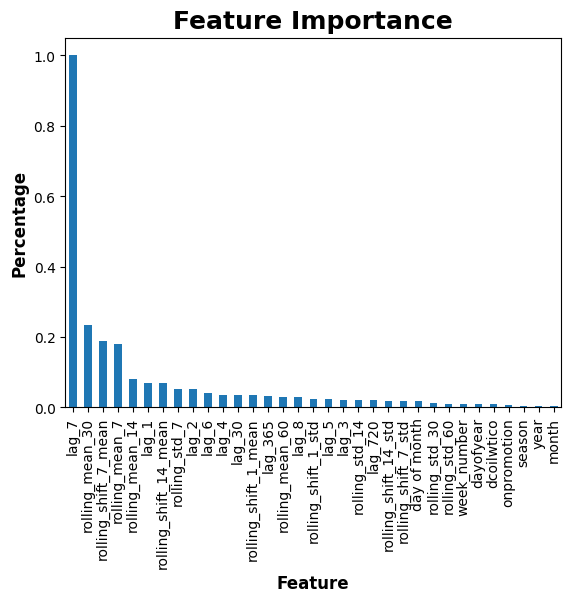

In [191]:
df = pd.DataFrame(feature_importance, columns=['Feature', 'Importance', 'Percentage', 'Cumulative'])

df = df[['Feature', 'Percentage']]

df.set_index('Feature', inplace=True)

df.plot(kind='bar', legend=None)
plt.xlabel('Feature')
plt.ylabel('Percentage')
plt.title('Feature Importance')
plt.show()

In [192]:
# model.save_mojo("random_forest_h2o.zip"


In [219]:
# import h2o.estimators as k
# print(dir(k))

In [194]:
# test_set_unknown=test_set[test_set.sales=="unknown"].drop(["sales","date"],axis=1)
# df = h2o.H2OFrame(test_set_unknown)

In [195]:
# pred_sales=model.predict(df)
# pred_sales[0:5]

In [196]:
# pred_sales_df = pred_sales.as_data_frame()

# # Convert DataFrame values to nested list
# values_list = pred_sales_df.values.tolist()


In [197]:
# sales=test_set.sales.values.tolist()
# pointer=0
# last_value=None
# for i in range(test_set.shape[0]):
#     if sales[i]=="unknown":
#         value=values_list[pointer][0]
#         sales[i]=value
#         pointer+=1
#         last_value=value
# print(sales[0:5])
# print(f"the last value is {last_value} and the last value of predictions is {values_list[-1]}")

In [198]:
# test_set_copy=test_set
# test_set_copy.sales=sales
# apply_styling_to_dataframe(test_set_copy.head())

In [199]:
# test_set_copy[["id","sales"]].to_csv("/kaggle/working/submission1.csv",index=False)

In [200]:
# instead of repeating the codes that i wrote above i create a func to calculate the submission for every algorithm a make using h2o library

def predict_h2o(model,all_sales,data,deleted_col,value):
    test_set_unknown=data[data.sales==value].drop(deleted_col,axis=1)
    df = h2o.H2OFrame(test_set_unknown)
    pred_sales=model.predict(df)
    pred_sales_df = pred_sales.as_data_frame()
    values_list = pred_sales_df.values.tolist()
    sales=all_sales.values.tolist()
    pointer=0
    last_value=None
    for i in range(data.shape[0]):
        if sales[i]==value:
            k=values_list[pointer][0]
            sales[i]=k
            pointer+=1
            last_value=k
    data_copy=data
    data_copy.sales=sales
    submission=data_copy[["id","sales"]]

<div style="border-radius:10px; padding: 10px; background-color: #d8b26e; font-size:130%; text-align:left">

i will try to billed a model for each product in each store

In [208]:
class Model_Each_product:
    def __init__(self,data_set):
        self.mae_arr=[]
        self.sum_mae=0
        self.count_mae=0
        self.store_product={}
        self.separating_product_store(data_set)
        
    def adding_lag_window_features(self,data):
        
        data["lag_1"]=data.sales.shift(1)
        data["lag_2"]=data.sales.shift(2)
        data["lag_3"]=data.sales.shift(3)
        data["lag_4"]=data.sales.shift(4)
        data["lag_5"]=data.sales.shift(5)
        data["lag_6"]=data.sales.shift(6)
        data["lag_7"]=data.sales.shift(7)
        data["lag_8"]=data.sales.shift(8)
        data["lag_30"]=data.sales.shift(30)
        data["lag_365"]=data.sales.shift(365)
        data["lag_720"]=data.sales.shift(720)

        window_size = 7  # You can adjust this window size as needed
        data["rolling_mean_7"] = data.sales.rolling(window=window_size).mean()
        data["rolling_std_7"] = data.sales.rolling(window=window_size).std()
        window_size = 14  # You can adjust this window size as needed
        data["rolling_mean_14"] = data.sales.rolling(window=window_size).mean()
        data["rolling_std_14"] = data.sales.rolling(window=window_size).std()
        window_size = 30  # You can adjust this window size as needed
        data["rolling_mean_30"] = data.sales.rolling(window=window_size).mean()
        data["rolling_std_30"] = data.sales.rolling(window=window_size).std()
        window_size = 60  # You can adjust this window size as needed
        data["rolling_mean_60"] = data.sales.rolling(window=window_size).mean()
        data["rolling_std_60"] = data.sales.rolling(window=window_size).std()


        # Rolling with shifts [1, 7, 14]
        shifts = [1, 7, 14]
        # Calculate rolling mean with shifts
        for shift in shifts:
            data[f'rolling_shift_{shift}_mean']=data.sales.shift(shift).rolling(window=3).mean()
            data[f'rolling_shift_{shift}_std']=data.sales.shift(shift).rolling(window=3).std()

        return data
    
    def separating_product_store(self,data_set):
        stores=data_set.store_nbr.unique().tolist()[0]
        products=data_set.family.unique().tolist()
        for store in [stores]:
            for product in products:
                group_product_store=data_set[(data_set.store_nbr==store)&(data_set.family==product)]
                group_product_store.drop(["store_nbr","family","date"],axis=1,inplace=True)
                group_product_store=self.adding_lag_window_features(group_product_store)
                evaluation_score_mae=self.building_model_xgboost_h2o(group_product_store)
                self.mae_arr.append(evaluation_score_mae)
                self.store_product[(f"store:{store}",f"product:{product}")]=evaluation_score_mae
                self.sum_mae+=evaluation_score_mae
                self.count_mae+=1
    def building_model_xgboost_h2o(self,data_set):
        train_features=data_set.columns.tolist()
        train_features.remove("sales")
        df = h2o.H2OFrame(k)

        # Define model
        model = H2ORandomForestEstimator(ntrees=30, max_depth=20, nfolds=5)

        # Train model 
        model.train(x=train_features, y="sales", training_frame=df)
        cv_summary = model.cross_validation_metrics_summary().as_data_frame()
        return cv_summary["mean"].values[0]

model_each_product=Model_Each_product(train_set)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████████| (done) 100%
Parse progress: |█████████████████████████████

In [211]:
print(model_each_product.sum_mae/model_each_product.count_mae)
print(model_each_product.store_product)

144.04625060606057
{('store:1', 'product:0'): 144.1072, ('store:1', 'product:2'): 143.73546, ('store:1', 'product:3'): 147.01895, ('store:1', 'product:4'): 143.62283, ('store:1', 'product:5'): 144.79185, ('store:1', 'product:6'): 146.1435, ('store:1', 'product:7'): 142.65602, ('store:1', 'product:8'): 143.88318, ('store:1', 'product:9'): 143.69943, ('store:1', 'product:10'): 142.2226, ('store:1', 'product:11'): 144.96904, ('store:1', 'product:12'): 145.55408, ('store:1', 'product:13'): 143.3499, ('store:1', 'product:14'): 145.77495, ('store:1', 'product:15'): 143.10881, ('store:1', 'product:16'): 143.8291, ('store:1', 'product:17'): 144.05869, ('store:1', 'product:18'): 141.97392, ('store:1', 'product:19'): 144.28471, ('store:1', 'product:20'): 143.94826, ('store:1', 'product:21'): 144.60225, ('store:1', 'product:22'): 144.79562, ('store:1', 'product:23'): 143.85211, ('store:1', 'product:24'): 144.73987, ('store:1', 'product:25'): 144.53258, ('store:1', 'product:26'): 144.22955, ('stor

<a id="libraries"></a>
# <b><span style='color:#c78a44'> 2. XGBoost</span></b>

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*yAGsAkwd4xnkHYErCyQl4Q.jpeg)

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*ozf-ftCx-jy2jII4cEv9YA.png)

In [246]:
k=bread_bakery_store_44.drop(["date"],axis=1)
df = h2o.H2OFrame(k)

model_xgboost=H2OXGBoostEstimator(
                                  nfolds=5
                                 )

# Train model 
model_xgboost.train(x=k.columns.tolist(), y="sales", training_frame=df)
cv_summary = model_xgboost.cross_validation_metrics_summary()
cv_summary

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
xgboost Model Build progress: |██████████████████████████████████████████████████| (done) 100%


,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
mae,145.11746,10.936553,137.64943,154.08676,134.49403,159.36742,139.98965
mean_residual_deviance,47183.445,7366.581,42949.812,48865.766,39328.492,58729.555,46043.6
mse,47183.445,7366.581,42949.812,48865.766,39328.492,58729.555,46043.6
r2,0.795778,0.0223374,0.8166506,0.7862622,0.8186168,0.7652016,0.7921586
residual_deviance,47183.445,7366.581,42949.812,48865.766,39328.492,58729.555,46043.6
rmse,216.7066,16.646696,207.24336,221.05603,198.31412,242.34181,214.57773
rmsle,0.3806322,0.1548352,0.1469212,0.3794802,0.3929086,0.4015087,0.5823424


<a id="libraries"></a>
# <b><span style='color:#c78a44'> 3. LGBMRegressor</span></b>

![](https://www.analyticssteps.com/backend/media/thumbnail/9271480/4488192_1593149293_Untitled-3.jpg)

In [263]:
model = LGBMRegressor(random_state=4) 
model.fit(bread_bakery_store_44.drop(["date"],axis=1), bread_bakery_store_44["sales"]) 

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000724 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7274
[LightGBM] [Info] Number of data points in the train set: 1684, number of used features: 34
[LightGBM] [Info] Start training from score 1385.426533


LGBMRegressor(random_state=4)

In [264]:

# Make predictions on the test set
y_pred = model.predict(bread_bakery_store_44.drop(["date"],axis=1))

# Calculate evaluation metrics
mae = mean_absolute_error(bread_bakery_store_44["sales"], y_pred)

print("Mean Absolute Error:", mae)


Mean Absolute Error: 4.847863689219869


In [306]:
class Building_Lightbgm(Model_Each_product):
    def __init__(self,data_set):
        self.mae_arr=[]
        self.store_product={}
        self.sum_mae=0
        self.count_mae=0
        self.separating_product_store(data_set)
    
    def separating_product_store(self,data_set):
        stores=data_set.store_nbr.unique().tolist()[0]
        for store in [stores]:
            products=train_set[train_set.store_nbr==store].family.unique().tolist()
            for product in products:
                group_product_store=data_set[(data_set.store_nbr==store)&(data_set.family==product)]
                group_product_store.drop(["store_nbr","family","date"],axis=1,inplace=True)
                group_product_store=self.adding_lag_window_features(group_product_store)
                evaluation_score_mae=self.building_model_lightgbm(group_product_store)
                self.mae_arr.append(evaluation_score_mae)
                self.store_product[(f"store:{store}",f"product:{product}")]=evaluation_score_mae
                self.sum_mae+=evaluation_score_mae
                self.count_mae+=1
    def building_model_lightgbm(self,data):
        x_train=data.drop(["sales"],axis=1)
        y_train=data["sales"]
        model = LGBMRegressor() 
        model.fit(x_train,y_train)
        y_pred = model.predict(x_train)
        mae = mean_absolute_error(y_train, y_pred)
        return mae
a=Building_Lightbgm(train_set)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3138
[LightGBM] [Info] Number of data points in the train set: 1684, number of used features: 32
[LightGBM] [Info] Start training from score 3.251188
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2622
[LightGBM] [Info] Number of data points in the train set: 1684, number of used features: 33
[LightGBM] [Info] Start training from score 2.408551
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of test

<a id="libraries"></a>
# <b><span style='color:#c78a44'> 4. Prophet</span></b>

In [283]:
tr=train_set_new[train_set_new.store_product=="5_1"]
tr=tr[["date","sales"]]
tr.columns=["ds","y"]
m=Prophet(interval_width=0.95,yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=True)

In [284]:
train_run=m.fit(tr)

14:34:21 - cmdstanpy - INFO - Chain [1] start processing
14:34:21 - cmdstanpy - INFO - Chain [1] done processing


In [285]:
tes=test_set_new[test_set_new.store_product=="5_5"]
tes=tes[["date"]]
tes.columns=["ds"]
tes.head()

,ds
2192,2017-08-16
2193,2017-08-17
2194,2017-08-18
2195,2017-08-19
2196,2017-08-20


In [286]:

forecast=m.predict(tes) 


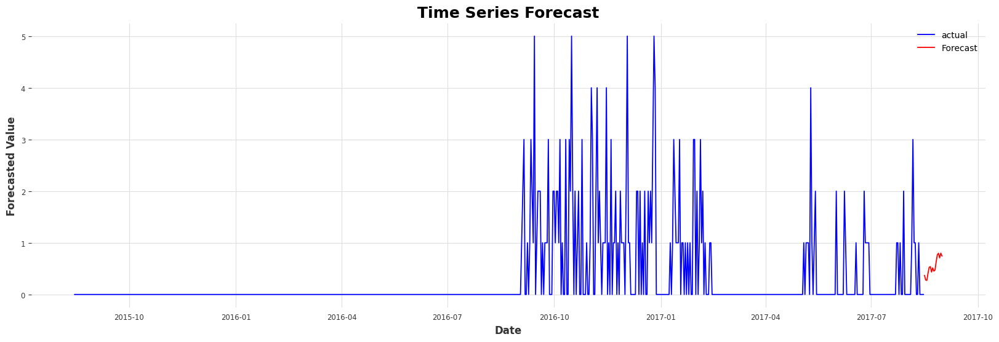

In [289]:
# Create a line plot
plt.figure(figsize=(20, 6))
plt.plot(tr['ds'], tr['y'], label='actual', color='b')
plt.plot(forecast['ds'], forecast['yhat'], label='Forecast', color='red')
# plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color='gray', alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Forecasted Value')
plt.title('Time Series Forecast')
plt.legend()
plt.show()

<a id="libraries"></a>
# <b><span style='color:#c78a44'> 5. darts library</span></b>

In [294]:
a=train_set_new[train_set_new.store_product=="1_0"].drop(["store_product"],axis=1)
y=TimeSeries.from_series(a["sales"])
features=["onpromotion","cluster","dcoilwtico","month","week_number","year","day of month","season","dayofyear"]
future_cov=TimeSeries.from_dataframe(a[features])
model=RegressionModel(
    lags=[-1,-2,-3,-5,-6,-7,-28],
    lags_future_covariates=[0,1,2],
    model=XGBRegressor(max_depth=6)
)
model.fit(y,future_covariates=future_cov)


RegressionModel(lags=[-1, -2, -3, -5, -6, -7, -28], lags_past_covariates=None, lags_future_covariates=[0, 1, 2], output_chunk_length=1, output_chunk_shift=0, add_encoders=None, model=XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...), multi_models=True, use_static_covariates=True)

In [295]:
y_pred=model.predict(n=730,series=y,future_covariates=future_cov)
# y_pred[:4]

ValueError: The `future_covariates` are not long enough. Given horizon `n=730`, `min(lags_future_covariates)=0`, `max(lags_future_covariates)=2` and `output_chunk_length=1`, the `future_covariates` have to range from 730 until 1461 (inclusive), but they only range from 0 until 729.

In [263]:
predicted_sales_values = y_pred.values()

a["predictions"]=predicted_sales_values
a.head()

,date,sales,predictions
time,,,
0,2015-08-15,3.00,2.37
1,2015-08-16,1.00,1.84
2,2015-08-17,0.00,6.64
3,2015-08-18,10.00,1.95
4,2015-08-19,4.00,3.38


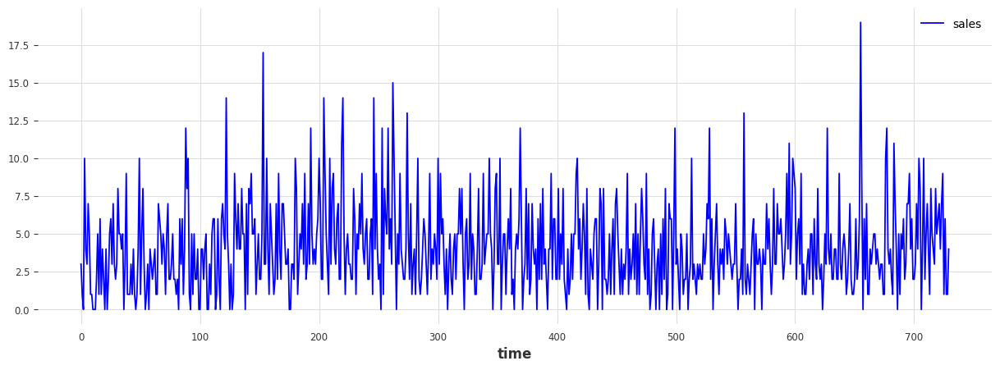

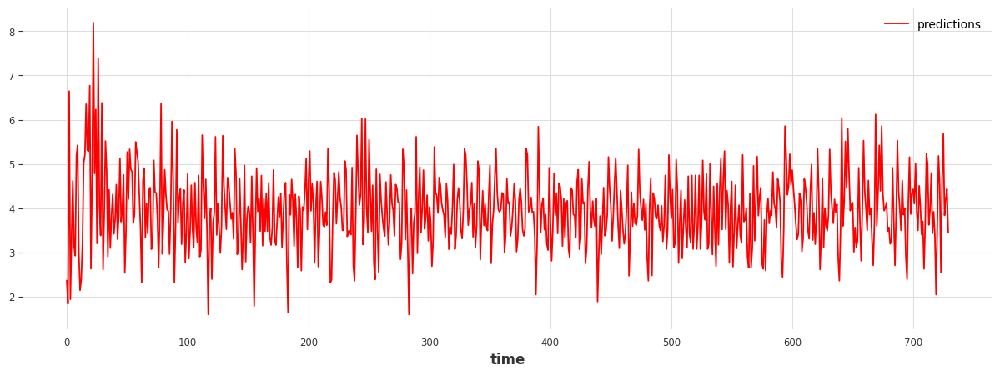

In [264]:
a[["sales"]].plot(figsize=(15,5),color="blue")
a[["predictions"]].plot(figsize=(15,5),color="red")

plt.show()